In [1]:
from pandas_datareader import data
import matplotlib.pyplot as plt
import yfinance as yf
import statsmodels.api as sm
import statsmodels.formula.api as smf 
from pypfopt.expected_returns import mean_historical_return
from pypfopt.risk_models import CovarianceShrinkage
import pyarrow.parquet as pq
import pickle
import numpy as np
import time
import seaborn as sns
from itertools import combinations
import multiprocessing as mp
from tqdm import tqdm
import sys
import pandas as pd
%load_ext autoreload
%autoreload 2
%config Completer.use_jedi = False

In [2]:
pd.set_option('display.max_columns', 50)
pd.set_option('display.max_rows', 500)

In [3]:
table2 = pq.read_table('E:\\Downloads\\stats-econ-homework\\obs_data.parquet')
base=table2.to_pandas()

In [5]:
len(base['id'].unique())

1000

In [6]:
base.describe()

,days_late,bureau_1,bureau_2,late_payments,std_revolving_balance_30,agreement_amount_mean,oustanting_balance_weight_30,oustanting_balance_weight_90,max_installments_balance_90,max_payment_90,sum_limit_request_time_weight_180,loss_balance,avg_late_balance_0_180,email_event_30,count_inbound_call_inbound_30,avg_call_duration_30,avg_installments_balance_30,charges_agreement_mean,ongoing_agreement_amount,asset_late_balance,ongoing_agreement_downpayment,recovery_balance,std_installments_balance_0_90,last_email_engagement,last_chat_engagement,finantial_institutions,downpayment_mean,avg_spends,score_1,score_2,score_3,income_score_1,count_previous_delinquencies,income_score_2,age,mean_previous_delinquencies_amount_weight_180,mean_previous_delinquencies_duration_90,score_max_credit_limit,credit_limit_utilization,sum_spends_360
count,53939.000000,53939.000000,53939.000000,53939.000000,53939.000000,8615.000000,53939.000000,53939.00000,53939.000000,53939.000000,53939.000000,53939.000000,53939.000000,53939.000000,53939.000000,53939.000000,53939.000000,8615.000000,2805.000000,53939.000000,2805.000000,53939.000000,53939.000000,29743.000000,27306.000000,53939.000000,8615.000000,18405.000000,53748.000000,53748.000000,53748.000000,53148.000000,53939.000000,53929.000000,53939.000000,53939.000000,53939.00000,53939.000000,53939.000000,53939.000000
mean,36.569328,0.008139,0.007879,11.509298,7.313094,1850.127104,278.680343,10.69117,11.636274,4160.861343,1.015740,531.582695,364.790245,0.567104,0.889412,2.242607,3.048851,7.209286,1786.373975,994.699568,295.381105,1.523109,5.993604,249.280839,146.428441,2.349228,374.941149,153.452323,569.106888,98.223041,157.192603,2007.253631,3.499564,4241.149604,41.168171,607.368323,11.30338,2252.656964,0.943232,206.534511
std,29.209864,0.089848,0.088416,21.098107,16.114278,1336.698371,1177.434203,16.77419,44.168598,6566.433172,0.250759,3882.446475,801.419988,0.495481,0.313624,2.525473,6.640371,6.087700,1312.558357,4313.561069,181.417646,1.497721,17.041722,265.343450,287.430953,2.116795,292.512281,224.118093,311.186577,109.960037,162.498358,1415.893616,2.457865,4927.987435,9.071001,2687.838813,22.12957,1938.205017,0.552118,1378.392582
min,0.000000,0.000000,0.000000,0.000000,-1.000000,261.000000,-39.000000,0.00000,0.000000,-755.000000,0.000000,-6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,273.000000,-74.000000,35.000000,0.000000,0.000000,8.000000,6.000000,0.000000,28.000000,2.000000,96.000000,2.000000,3.000000,124.000000,0.000000,118.000000,19.000000,-300.000000,0.00000,192.000000,0.000000,0.000000
25%,14.000000,0.000000,0.000000,0.000000,3.000000,993.000000,40.000000,2.00000,1.000000,877.000000,1.000000,23.000000,111.000000,0.000000,1.000000,1.000000,1.000000,3.000000,969.000000,6.000000,171.000000,1.000000,0.000000,95.000000,73.000000,1.000000,178.000000,39.000000,357.000000,33.000000,56.000000,1079.000000,2.000000,1382.000000,35.000000,65.000000,1.00000,1058.000000,1.000000,1.000000
50%,30.000000,0.000000,0.000000,0.000000,4.000000,1451.000000,91.000000,5.00000,2.000000,2195.000000,1.000000,32.000000,129.000000,1.000000,1.000000,2.000000,1.000000,5.000000,1381.000000,64.000000,239.000000,1.000000,1.000000,171.000000,100.000000,2.000000,270.000000,89.000000,494.000000,65.000000,108.000000,1627.000000,3.000000,2490.000000,40.000000,87.000000,4.00000,1732.000000,1.000000,7.000000
75%,53.000000,0.000000,0.000000,10.000000,7.000000,2294.000000,206.000000,11.00000,6.000000,4810.000000,1.000000,99.000000,334.000000,1.000000,1.000000,3.000000,3.000000,9.000000,2207.000000,323.000000,361.000000,2.000000,4.000000,298.000000,143.000000,3.000000,480.000000,188.000000,699.000000,118.000000,200.000000,2513.000000,5.000000,5249.000000,46.000000,423.000000,11.00000,2766.000000,1.000000,43.000000
max,165.000000,1.000000,1.000000,620.000000,566.000000,9471.000000,38632.000000,183.00000,1029.000000,93248.000000,4.000000,80193.000000,19486.000000,1.000000,1.000000,61.000000,117.000000,57.000000,8764.000000,66316.00000

In [11]:
base[base['bureau_1']==1].head()

,id,date,collections_start,days_late,bureau_1,bureau_2,late_payments,collection__end,std_revolving_balance_30,agreement_amount_mean,oustanting_balance_weight_30,oustanting_balance_weight_90,max_installments_balance_90,max_payment_90,sum_limit_request_time_weight_180,loss_balance,avg_late_balance_0_180,email_event_30,count_inbound_call_inbound_30,avg_call_duration_30,avg_installments_balance_30,charges_agreement_mean,ongoing_agreement_amount,asset_late_balance,ongoing_agreement_downpayment,recovery_balance,std_installments_balance_0_90,last_email_engagement,last_chat_engagement,finantial_institutions,downpayment_mean,avg_spends,score_1,score_2,score_3,income_score_1,count_previous_delinquencies,income_score_2,age,mean_previous_delinquencies_amount_weight_180,mean_previous_delinquencies_duration_90,score_max_credit_limit,credit_limit_utilization,sum_spends_360
804,ee254bce-3eec-46cd-a440-826631a44783,2017-01-16,2017-01-01,15,1,0,0,2017-06-14,0.0,NaN,127.0,2.0,0.0,18.0,1.0,33.0,28.0,1.0,0.0,0.0,0.0,NaN,NaN,0.0,NaN,1.0,0.0,NaN,65.0,4.0,NaN,176.0,342.0,214.0,323.0,1012.0,1.0,15828.0,45.0,3.0,0.0,2111.0,1.0,18.0
845,e4552188-6002-44f4-b539-1043cf1dd057,2017-01-16,2017-01-01,15,1,0,50,2017-03-01,9.0,NaN,40.0,13.0,0.0,0.0,1.0,0.0,158.0,1.0,1.0,8.0,3.0,NaN,NaN,54.0,NaN,0.0,0.0,54.0,NaN,1.0,NaN,140.0,389.0,58.0,119.0,1624.0,4.0,3786.0,40.0,142.0,17.0,2148.0,1.0,43.0
873,f84bc28e-7298-4d59-a315-5a3c1125f820,2017-01-16,2017-01-01,15,1,0,30,NaT,0.0,1587.0,32.0,12.0,4.0,29579.0,1.0,0.0,178.0,0.0,1.0,2.0,0.0,5.0,NaN,102.0,NaN,2.0,3.0,97.0,NaN,1.0,265.0,NaN,856.0,28.0,42.0,1951.0,2.0,3301.0,43.0,296.0,10.0,1562.0,2.0,140.0
880,40249e57-7de1-42fb-9201-afab1a3965a4,2017-01-16,2017-01-01,15,1,0,20,2017-02-18,2.0,NaN,17.0,51.0,0.0,0.0,2.0,0.0,2824.0,0.0,1.0,14.0,1.0,NaN,NaN,16662.0,NaN,0.0,0.0,79.0,NaN,1.0,NaN,165.0,1211.0,14.0,22.0,3253.0,1.0,951.0,38.0,7637.0,63.0,4323.0,3.0,4293.0
898,abd31cd5-ccc6-415c-9c76-124a01f6c898,2017-01-17,2017-01-02,15,1,0,0,2017-03-31,0.0,NaN,50.0,10.0,0.0,879.0,1.0,4.0,441.0,1.0,1.0,2.0,0.0,NaN,NaN,110.0,NaN,2.0,0.0,58.0,37.0,0.0,NaN,67.0,523.0,47.0,66.0,1724.0,9.0,15113.0,38.0,349.0,14.0,3026.0,1.0,46.0


In [14]:
base[base['bureau_2']==1].head()

,id,date,collections_start,days_late,bureau_1,bureau_2,late_payments,collection__end,std_revolving_balance_30,agreement_amount_mean,oustanting_balance_weight_30,oustanting_balance_weight_90,max_installments_balance_90,max_payment_90,sum_limit_request_time_weight_180,loss_balance,avg_late_balance_0_180,email_event_30,count_inbound_call_inbound_30,avg_call_duration_30,avg_installments_balance_30,charges_agreement_mean,ongoing_agreement_amount,asset_late_balance,ongoing_agreement_downpayment,recovery_balance,std_installments_balance_0_90,last_email_engagement,last_chat_engagement,finantial_institutions,downpayment_mean,avg_spends,score_1,score_2,score_3,income_score_1,count_previous_delinquencies,income_score_2,age,mean_previous_delinquencies_amount_weight_180,mean_previous_delinquencies_duration_90,score_max_credit_limit,credit_limit_utilization,sum_spends_360
1053,e4552188-6002-44f4-b539-1043cf1dd057,2017-01-18,2017-01-01,17,0,1,0,2017-03-01,9.0,NaN,40.0,13.0,0.0,0.0,1.0,0.0,158.0,1.0,1.0,8.0,3.0,NaN,NaN,54.0,NaN,0.0,0.0,NaN,NaN,1.0,NaN,140.0,389.0,58.0,119.0,1624.0,4.0,3786.0,40.0,142.0,17.0,2148.0,1.0,43.0
1068,d3005d9c-2d58-4986-9007-67a6758dd7ef,2017-01-18,2017-01-01,17,0,1,0,2017-02-15,1.0,NaN,117.0,7.0,0.0,33240.0,2.0,42.0,43.0,1.0,1.0,2.0,0.0,NaN,NaN,7.0,NaN,1.0,0.0,149.0,30.0,2.0,NaN,NaN,787.0,98.0,134.0,900.0,1.0,4691.0,35.0,1.0,6.0,2690.0,1.0,10.0
1090,40249e57-7de1-42fb-9201-afab1a3965a4,2017-01-18,2017-01-01,17,0,1,0,2017-02-18,2.0,NaN,17.0,51.0,0.0,0.0,2.0,0.0,2824.0,0.0,1.0,14.0,1.0,NaN,NaN,16662.0,NaN,0.0,0.0,NaN,31.0,1.0,NaN,165.0,1211.0,14.0,22.0,3253.0,1.0,951.0,38.0,7637.0,63.0,4323.0,3.0,4293.0
1107,abd31cd5-ccc6-415c-9c76-124a01f6c898,2017-01-19,2017-01-02,17,0,1,0,2017-03-31,0.0,2895.0,50.0,10.0,0.0,879.0,1.0,4.0,441.0,1.0,1.0,2.0,0.0,21.0,NaN,110.0,NaN,2.0,0.0,58.0,37.0,0.0,153.0,NaN,523.0,47.0,66.0,1724.0,9.0,15113.0,38.0,349.0,14.0,3026.0,1.0,46.0
1153,d504d6a1-1f80-4836-9c04-75f4acfbeea4,2017-01-19,2017-01-02,17,0,1,0,2017-04-24,1.0,NaN,110.0,3.0,0.0,162.0,1.0,167.0,21.0,1.0,1.0,2.0,0.0,NaN,NaN,5.0,NaN,7.0,0.0,NaN,164.0,1.0,NaN,134.0,884.0,47.0,135.0,1702.0,3.0,1859.0,37.0,22.0,0.0,667.0,1.0,26.0


In [13]:
base.groupby(['bureau_1','bureau_2']).mean()

days_late  late_payments  std_revolving_balance_30  \
bureau_1 bureau_2                                                       
0        0         36.904437      11.457748                  7.288780   
         1         17.000000      11.835294                  8.680000   
1        0         15.000000      17.425968                  8.929385   

                   agreement_amount_mean  oustanting_balance_weight_30  \
bureau_1 bureau_2                                                        
0        0                   1845.482665                    279.156835   
         1                   1900.312500                    222.395294   
1        0                   2359.605634                    275.562642   

                   oustanting_balance_weight_90  max_installments_balance_90  \
bureau_1 bureau_2                                                              
0        0                            10.645765                    11.580236   
         1                            14.611765                    15.750588   
1        0                            12.384966                    14.428246   

                   max_payment_90  sum_limit_request_time_weight_180  \
bureau_1 bureau_2                                                      
0        0            4148.699651                           1.015506   
         1            5011.247059                           1.030588   
1        0            4807.940774                           1.029613   

                   loss_balance  avg_late_balance_0_180  email_event_30  \
bureau_1 bureau_2                                                         
0        0           534.937070              362.971493        0.566802   
         1           257.868235              510.832941        0.588235   
1        0           391.025057              443.291572        0.583144   

                   count_inbound_call_inbound_30  avg_call_duration_30  \
bureau_1 bureau_2                                                        
0        0                              0.890061              2.238210   
         1                              0.856471              2.602353   
1        0                              0.842825              2.425968   

                   avg_installments_balance_30  charges_agreement_mean  \
bureau_1 bureau_2                                                        
0        0                            3.041564                7.195991   
         1                            3.720000                7.000000   
1        0                            3.280182                8.985915   

                   ongoing_agreement_amount  asset_late_balance  \
bureau_1 bureau_2                                                 
0        0                      1779.446014          986.901441   
         1                      2528.727273         1488.063529   
1        0                      1907.652174         1459.861048   

                   ongoing_agreement_downpayment  recovery_balance  \
bureau_1 bureau_2                                                    
0        0                            294.529710          1.525294   
         1                            418.409091          1.407059   
1        0                            279.869565          1.371298   

                   std_installments_balance_0_90  last_email_engagement  \
bureau_1 bureau_2                                                         
0        0                              5.971192             249.563882   
         1                              7.644706             235.883117   
1        0                              7.104784             228.275304   

                   last_chat_engagement  finantial_institutions  \
bureau_1 bureau_2                                                 
0        0                   146.847967                2.347376   
         1                   112.973094                2.536471   
1        0                   129.660793                2.391800   

   

In [15]:
bureau_1=base[base['bureau_1']==1]['id'].unique()
bureau_2=base[base['bureau_2']==1]['id'].unique()

In [16]:
control=list((set(base['id'])-set(bureau_1))-set(bureau_2))

In [17]:
both=set(bureau_1) & set(bureau_2)

In [18]:
treatment1=set(bureau_1) - set(bureau_2)

In [19]:
treatment2=set(bureau_2) - set(bureau_1)

In [20]:
base.loc[base['id'].isin(control),'type_obs']='control'

In [21]:

base.loc[base['id'].isin(both),'type_obs']='both'
base.loc[base['id'].isin(treatment1),'type_obs']='bureau_1'
base.loc[base['id'].isin(treatment2),'type_obs']='bureau_2'


In [22]:
groupavgs=base.fillna(0).groupby(['days_late','type_obs']).mean()
groupmean=base.fillna(0).groupby(['days_late','type_obs']).median()
groupastd=base.fillna(0).groupby(['days_late','type_obs']).std()

In [23]:
groupavgs=groupavgs.unstack()

In [24]:
base['collection_time']=base['collection__end']-base['collections_start']

In [34]:
max_date_obs=base[base['days_late']>=15].groupby('id')['date'].idxmax().reset_index()
min_date_obs=base[base['id'].isin(max_date_obs['id'])].groupby('id')['date'].idxmin().reset_index()

In [32]:
pars=base.loc[ max_date_obs['date']].fillna(0).groupby(['type_obs'])['id'].count()


C:\Users\Rafael\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: Passing integers to fillna is deprecated, will raise a TypeError in a future version.  To retain the old behavior, pass pd.Timedelta(seconds=n) instead.
  """Entry point for launching an IPython kernel.


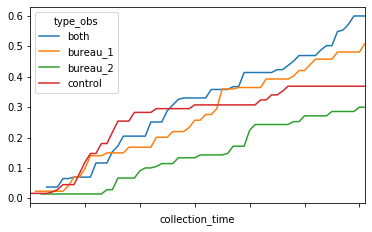

In [33]:
base.loc[ (max_date_obs['date'] & pd.notna(base['collection__end'])) ].groupby(['type_obs','collection_time'])['id'].count().unstack().T.div(pars).cumsum().fillna(method='ffill').plot()

In [35]:
start_mean=base.loc[min_date_obs['date']].fillna(0).groupby('type_obs').mean().T
end_mean=base.loc[ max_date_obs['date']].fillna(0).groupby('type_obs').mean().T

C:\Users\Rafael\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: Passing integers to fillna is deprecated, will raise a TypeError in a future version.  To retain the old behavior, pass pd.Timedelta(seconds=n) instead.
  """Entry point for launching an IPython kernel.
C:\Users\Rafael\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: Passing integers to fillna is deprecated, will raise a TypeError in a future version.  To retain the old behavior, pass pd.Timedelta(seconds=n) instead.
  


In [58]:
start_mean=base.loc[min_date_obs['date']].fillna(0).groupby('type_obs').count().T
end_mean=base.loc[ max_date_obs['date']].fillna(0).groupby('type_obs').count().T

C:\Users\Rafael\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: Passing integers to fillna is deprecated, will raise a TypeError in a future version.  To retain the old behavior, pass pd.Timedelta(seconds=n) instead.
  """Entry point for launching an IPython kernel.
C:\Users\Rafael\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: Passing integers to fillna is deprecated, will raise a TypeError in a future version.  To retain the old behavior, pass pd.Timedelta(seconds=n) instead.
  


In [61]:
start_mean

type_obs,both,bureau_1,bureau_2,control
id,215,224,210,253
date,215,224,210,253
collections_start,215,224,210,253
days_late,215,224,210,253
bureau_1,215,224,210,253
bureau_2,215,224,210,253
late_payments,215,224,210,253
collection__end,215,224,210,253
std_revolving_balance_30,215,224,210,253
agreement_amount_mean,215,224,210,253


In [37]:
(end_mean-start_mean)/start_mean

type_obs,both,bureau_1,bureau_2,control
days_late,inf,inf,inf,inf
bureau_1,NaN,inf,NaN,NaN
bureau_2,inf,NaN,inf,NaN
late_payments,0.568306,0.029851,0.219298,0.040000
std_revolving_balance_30,-0.322351,-0.141433,-0.026806,-0.120770
agreement_amount_mean,0.154006,0.484398,0.421560,0.278320
oustanting_balance_weight_30,0.000624,0.049757,-0.072986,-0.063701
oustanting_balance_weight_90,0.018705,0.017563,0.001918,0.002055
max_installments_balance_90,-0.033030,-0.044133,-0.097698,-0.011023
max_payment_90,-0.183962,-0.143432,-0.111333,0.011966


In [63]:
time=base.loc[ max_date_obs['date']].fillna(0).groupby(['type_obs','collection_time'])['id'].count().unstack().T

C:\Users\Rafael\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: Passing integers to fillna is deprecated, will raise a TypeError in a future version.  To retain the old behavior, pass pd.Timedelta(seconds=n) instead.
  """Entry point for launching an IPython kernel.


In [64]:
time=base.loc[ max_date_obs['date']][['type_obs','collection_time']]

In [49]:
max_date_obs=base[base['days_late']>=0].groupby('id')['date'].idxmax().reset_index()

In [56]:
time2=base.loc[ max_date_obs['date']].fillna(0)[['type_obs','days_late']]
time3=base.loc[ max_date_obs['date']][pd.isnull(base['collection_time'])][['type_obs','days_late']]

C:\Users\Rafael\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: Passing integers to fillna is deprecated, will raise a TypeError in a future version.  To retain the old behavior, pass pd.Timedelta(seconds=n) instead.
  """Entry point for launching an IPython kernel.
C:\Users\Rafael\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


In [41]:
base.loc[base['id'].isin(base[ pd.isnull(base['collection__end'])]['id'])].dropna(subset=['collection__end'])

,id,date,collections_start,days_late,bureau_1,bureau_2,late_payments,collection__end,std_revolving_balance_30,agreement_amount_mean,oustanting_balance_weight_30,oustanting_balance_weight_90,max_installments_balance_90,max_payment_90,sum_limit_request_time_weight_180,loss_balance,avg_late_balance_0_180,email_event_30,count_inbound_call_inbound_30,avg_call_duration_30,avg_installments_balance_30,charges_agreement_mean,ongoing_agreement_amount,asset_late_balance,ongoing_agreement_downpayment,recovery_balance,std_installments_balance_0_90,last_email_engagement,last_chat_engagement,finantial_institutions,downpayment_mean,avg_spends,score_1,score_2,score_3,income_score_1,count_previous_delinquencies,income_score_2,age,mean_previous_delinquencies_amount_weight_180,mean_previous_delinquencies_duration_90,score_max_credit_limit,credit_limit_utilization,sum_spends_360,type_obs,collection_time


tiddme.dddropna()

In [66]:
time['collection_time']=time['collection_time'].dt.days

In [43]:
base.loc[ max_date_obs['date']  ].fillna[(base['days_late']!=base['collection_time'])][['days_late','collection_time']]

C:\Users\Rafael\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


,days_late,collection_time
17429,75,75 days
53745,118,NaT
53811,27,NaT
29115,58,58 days
53751,16,NaT
53885,79,NaT
53759,55,NaT
9088,25,25 days
18657,24,24 days
53591,157,NaT


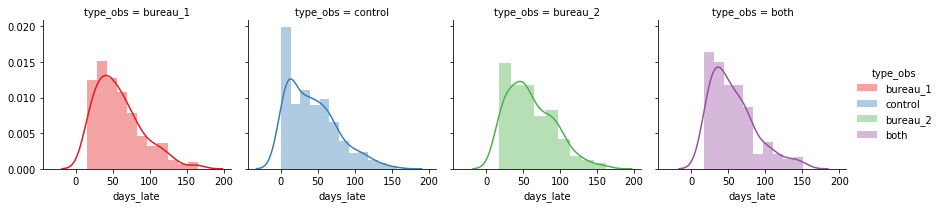

In [51]:
g = sns.FacetGrid(time2, col="type_obs",hue="type_obs", palette="Set1")
g = (g.map(sns.distplot, 'days_late',hist=True))
g.add_legend()

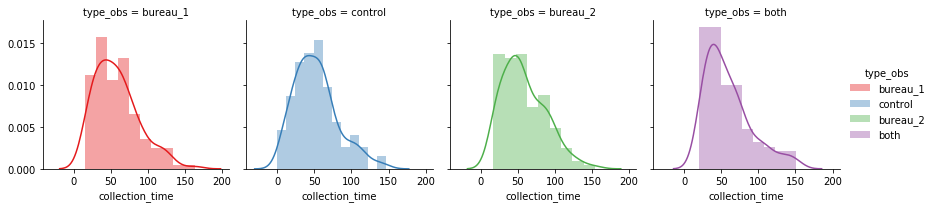

In [67]:

g = sns.FacetGrid(time, col="type_obs",hue="type_obs", palette="Set1")
g = (g.map(sns.distplot, "collection_time",hist=True))
g.add_legend()

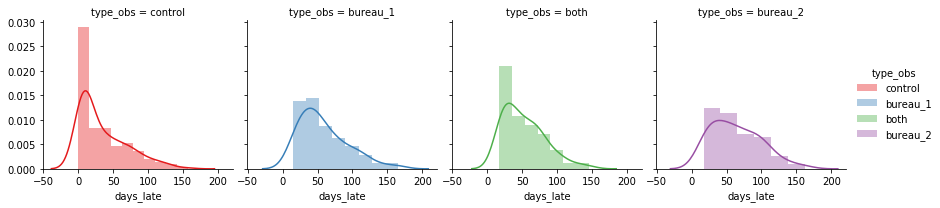

In [57]:
g = sns.FacetGrid(time3, col="type_obs",hue="type_obs", palette="Set1")
g = (g.map(sns.distplot,  'days_late',hist=True))
g.add_legend()

In [445]:
time3

,type_obs,days_late
5,bureau_1,0
40,bureau_1,2
61,bureau_1,3
124,bureau_1,2
143,bureau_1,5
188,bureau_1,6
196,bureau_2,3
216,bureau_1,4
239,bureau_1,7
247,bureau_2,4


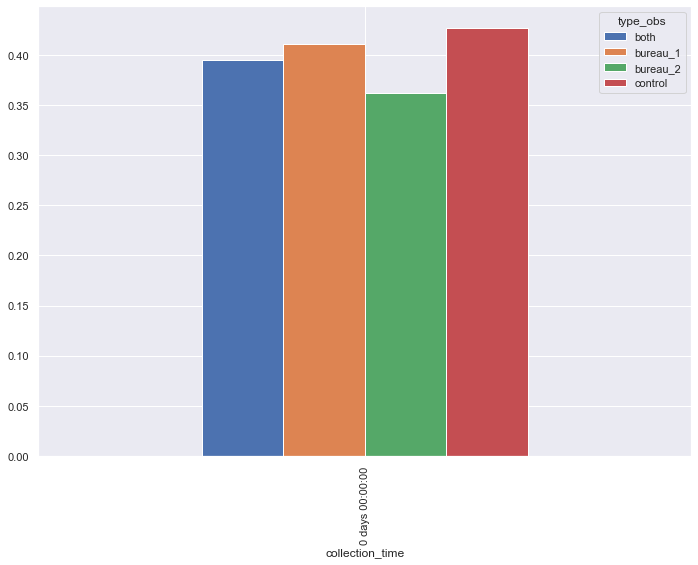

In [181]:
(time/time.sum())[time.index<'2days'].plot(kind='bar')

In [155]:
max_date_obs_filter=(base['id'].isin(max_date_obs['id']) & base['date'].isin(max_date_obs['date']))

In [284]:
groupavgs=base.groupby(['days_late','type_obs']).mean()

id
date
collections_start
days_late
bureau_1


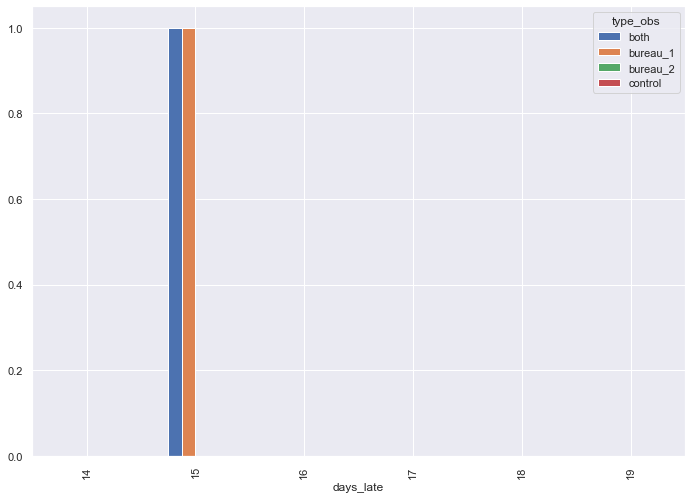

bureau_2


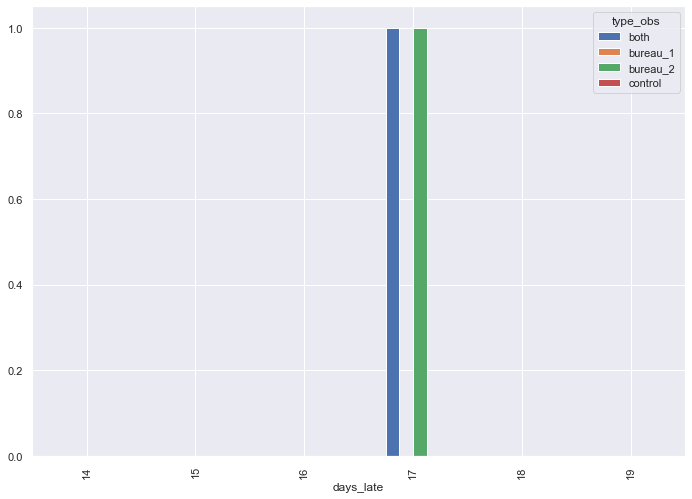

late_payments


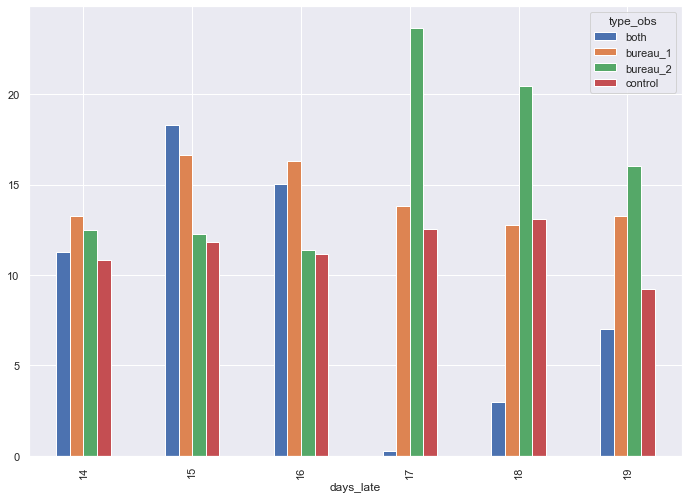

collection__end
std_revolving_balance_30


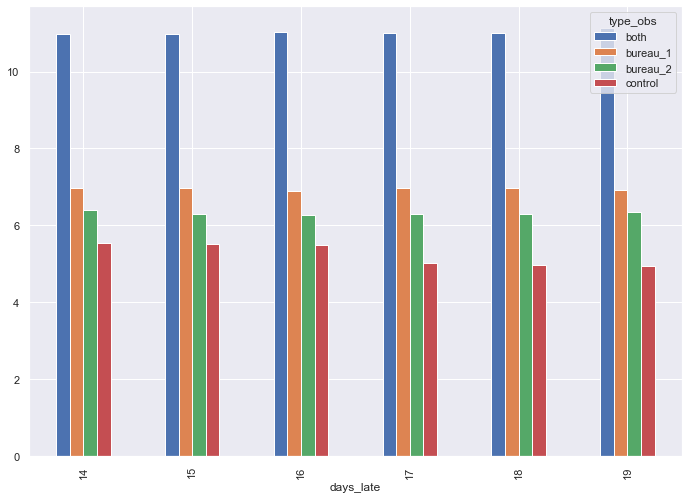

agreement_amount_mean


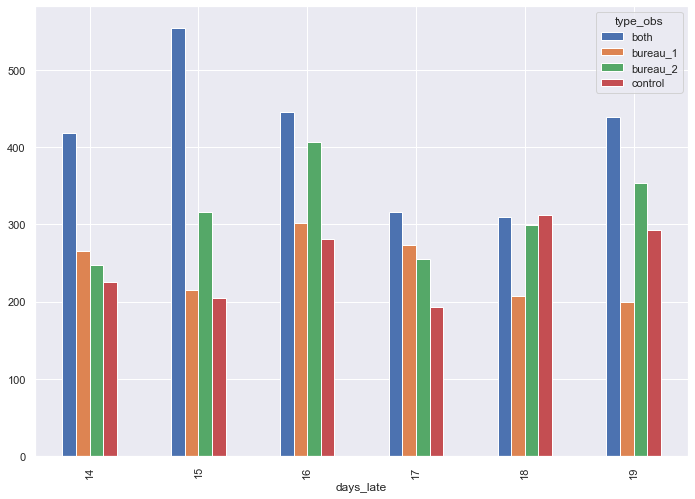

oustanting_balance_weight_30


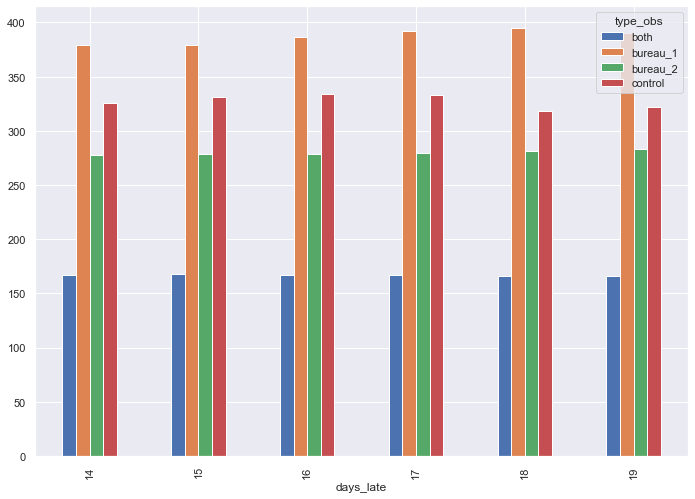

oustanting_balance_weight_90


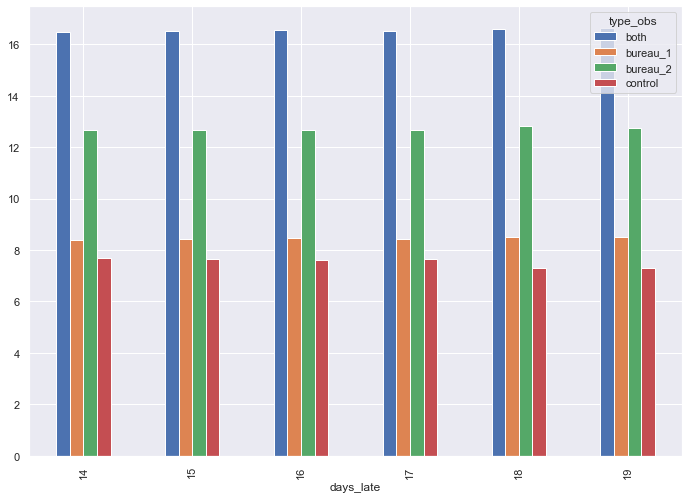

max_installments_balance_90


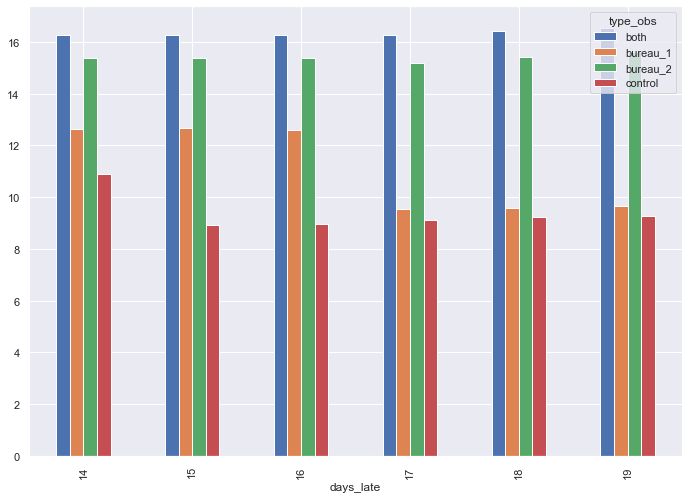

max_payment_90


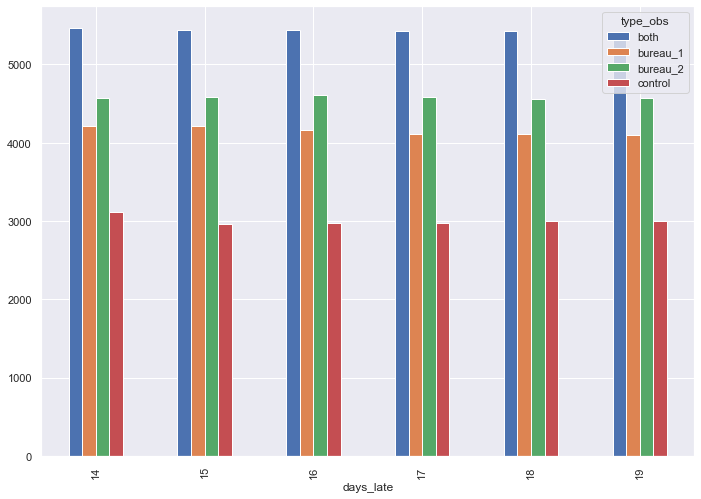

sum_limit_request_time_weight_180


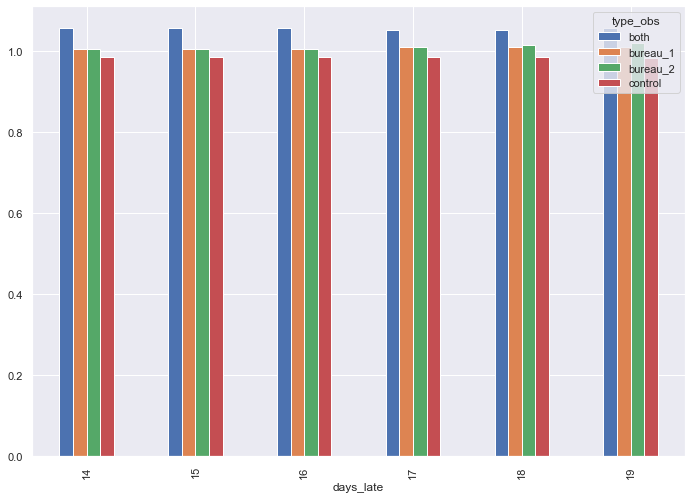

loss_balance


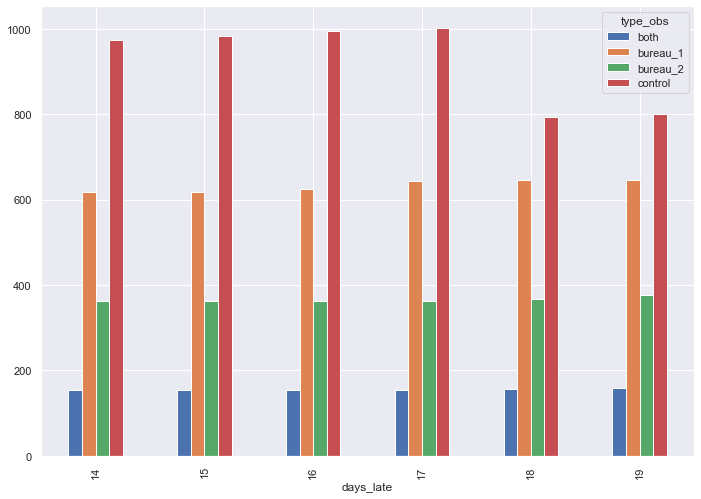

avg_late_balance_0_180


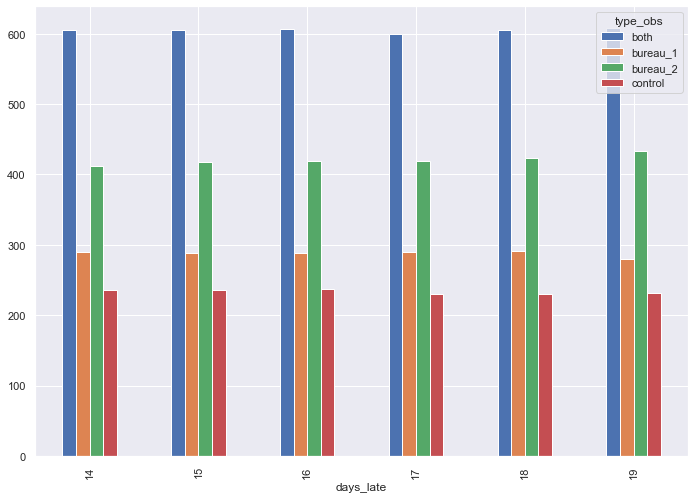

email_event_30


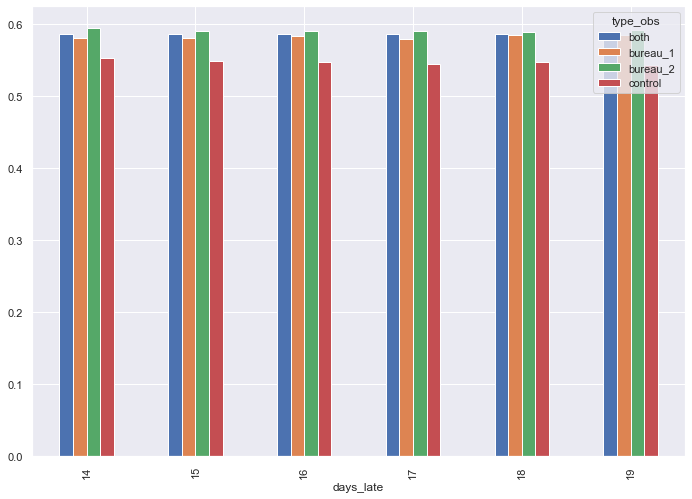

count_inbound_call_inbound_30


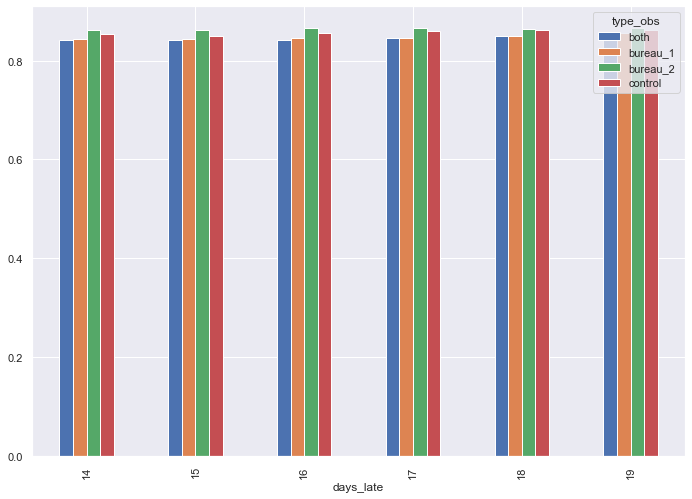

avg_call_duration_30


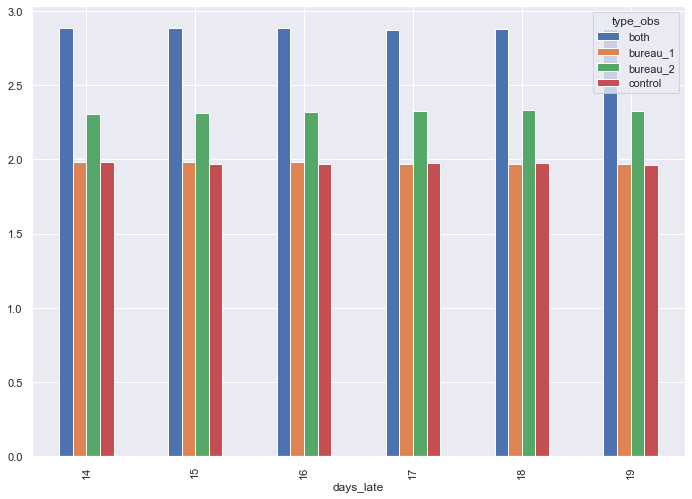

avg_installments_balance_30


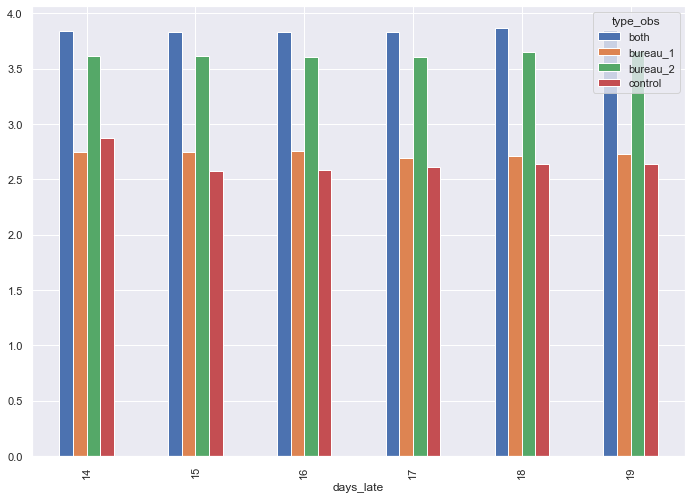

charges_agreement_mean


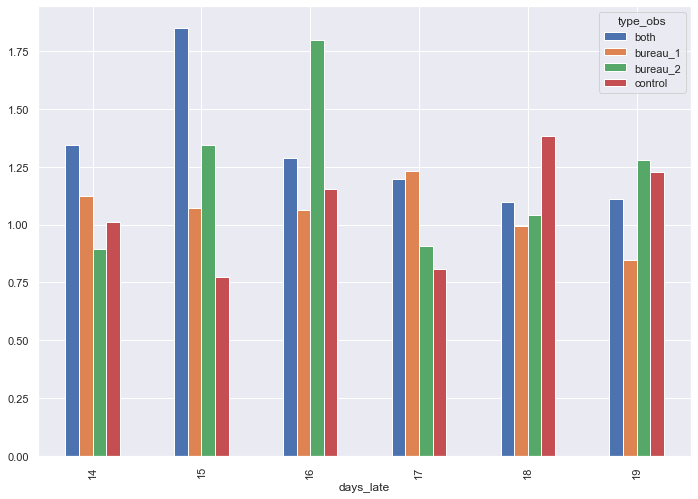

ongoing_agreement_amount


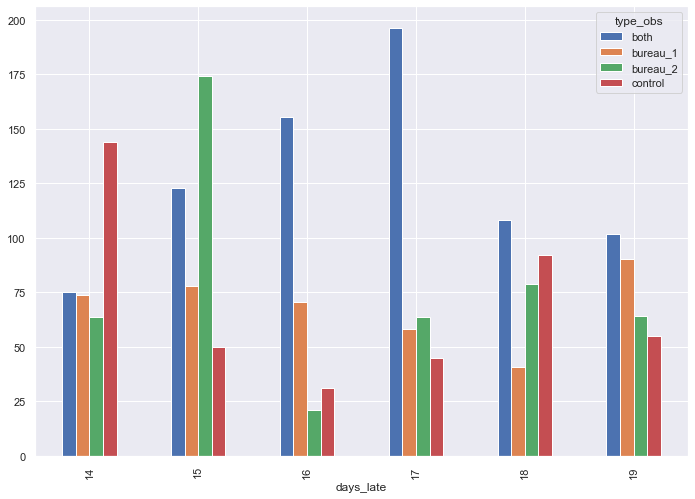

asset_late_balance


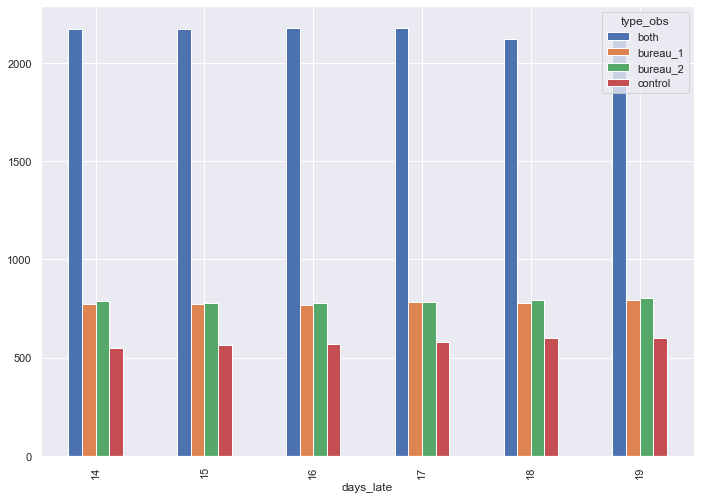

ongoing_agreement_downpayment


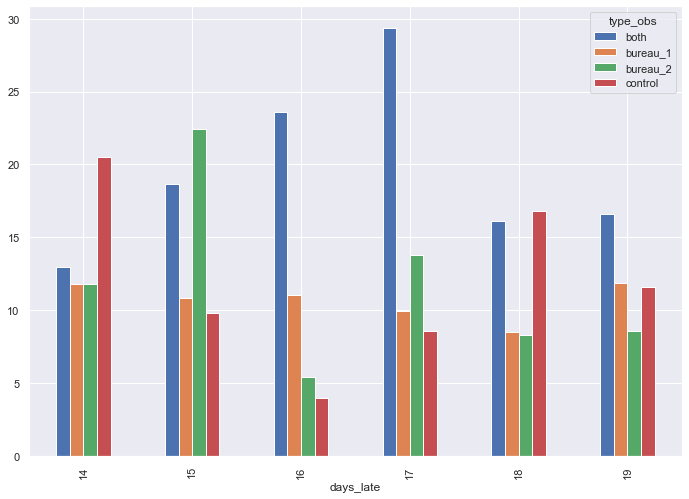

recovery_balance


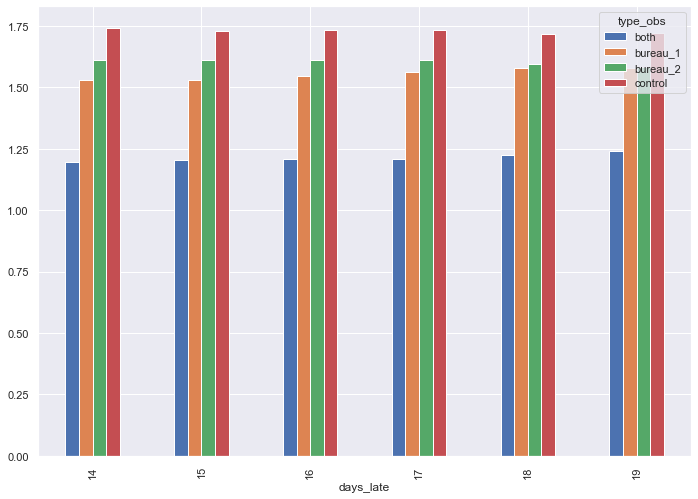

std_installments_balance_0_90


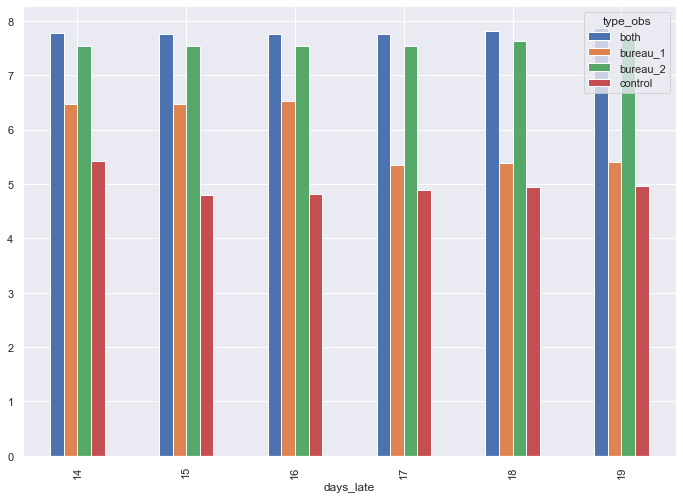

last_email_engagement


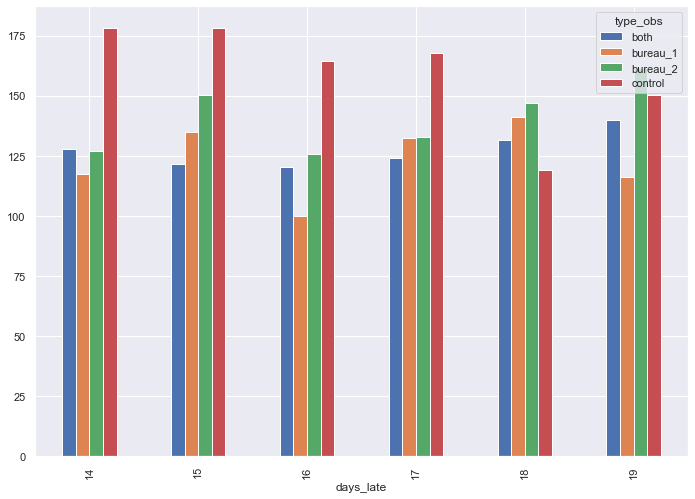

last_chat_engagement


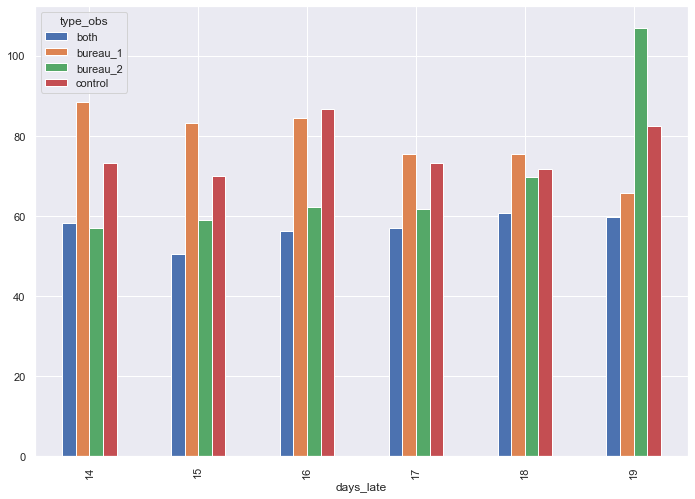

finantial_institutions


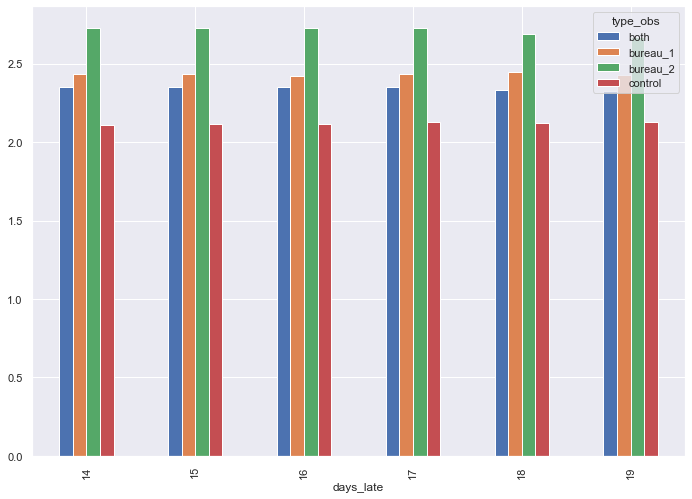

downpayment_mean


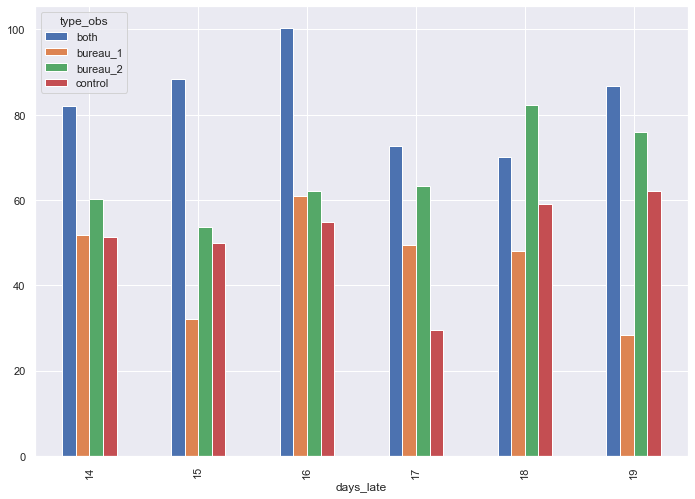

avg_spends


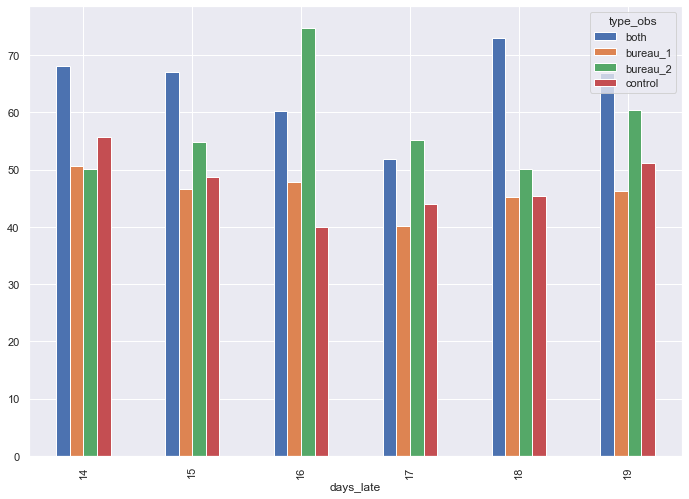

score_1


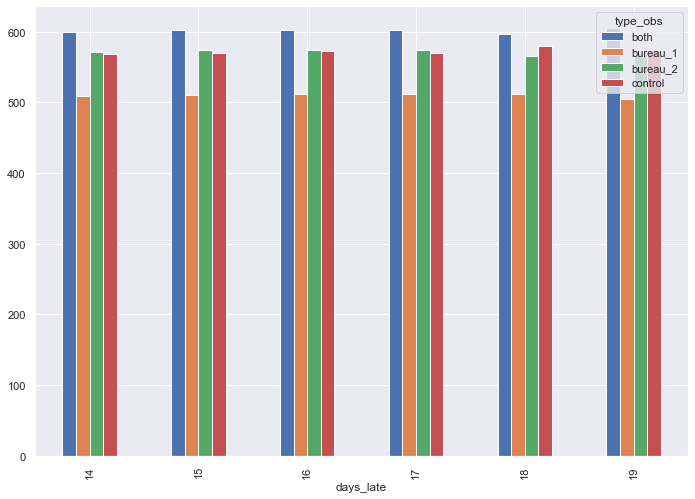

score_2


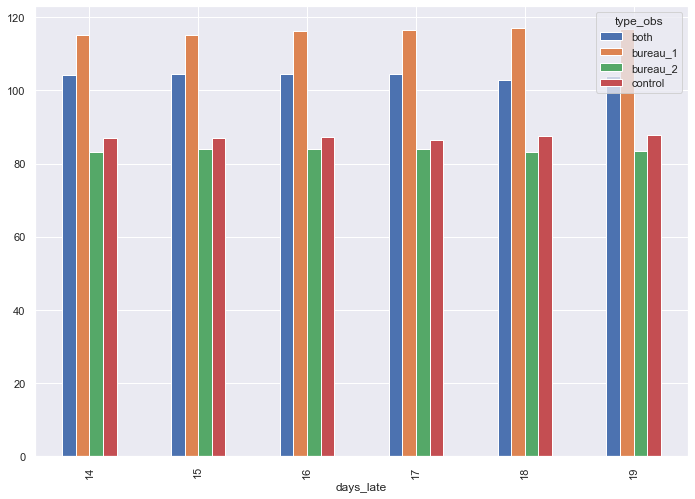

score_3


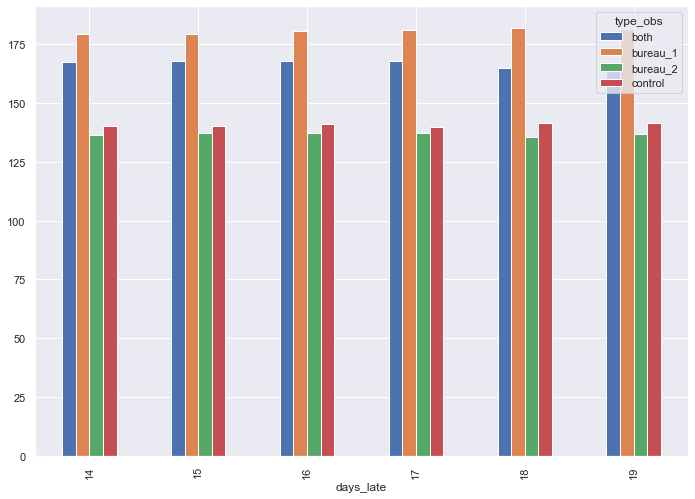

income_score_1


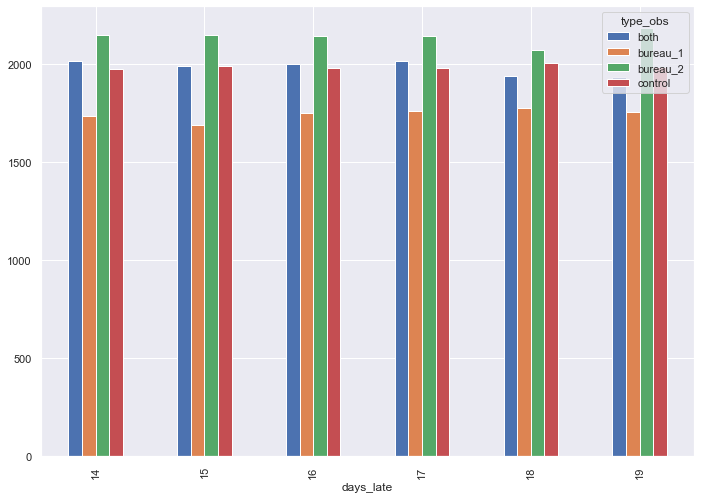

count_previous_delinquencies


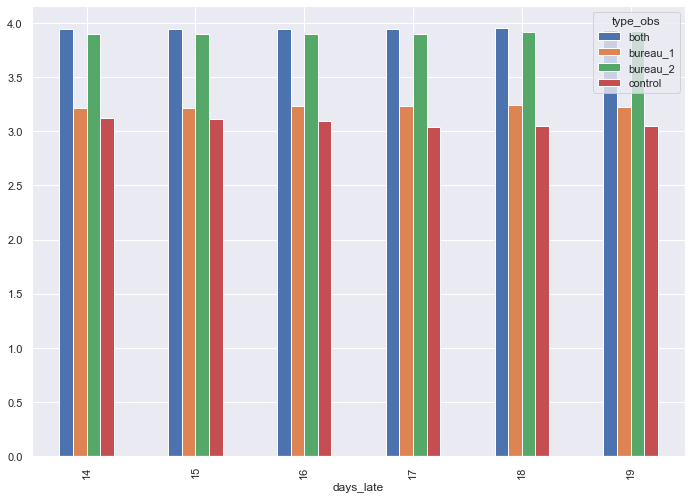

income_score_2


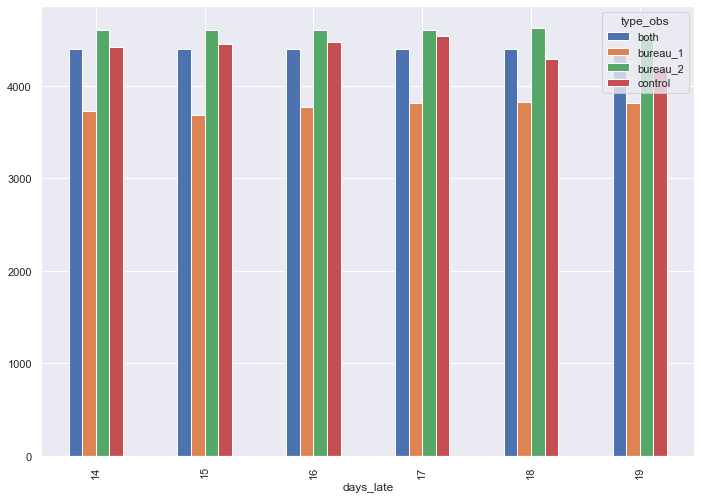

age


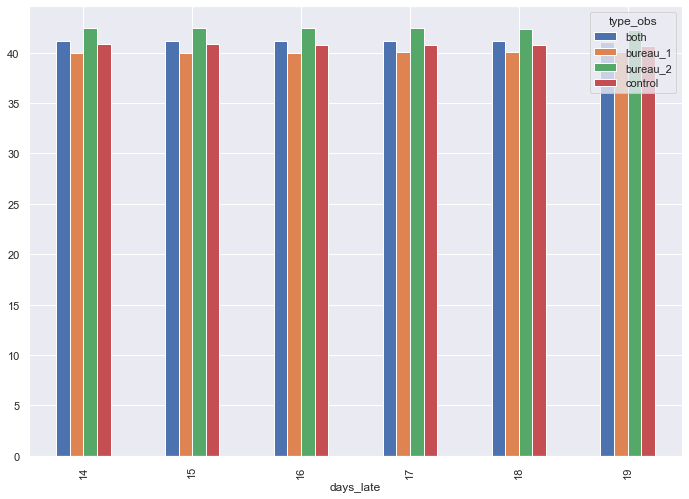

mean_previous_delinquencies_amount_weight_180


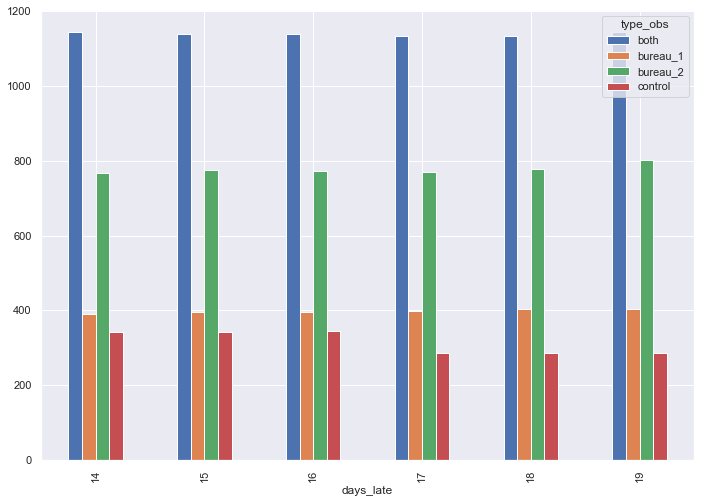

mean_previous_delinquencies_duration_90


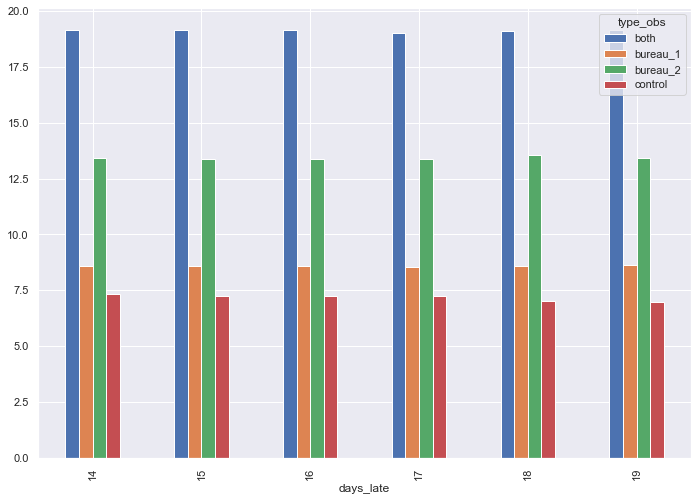

score_max_credit_limit


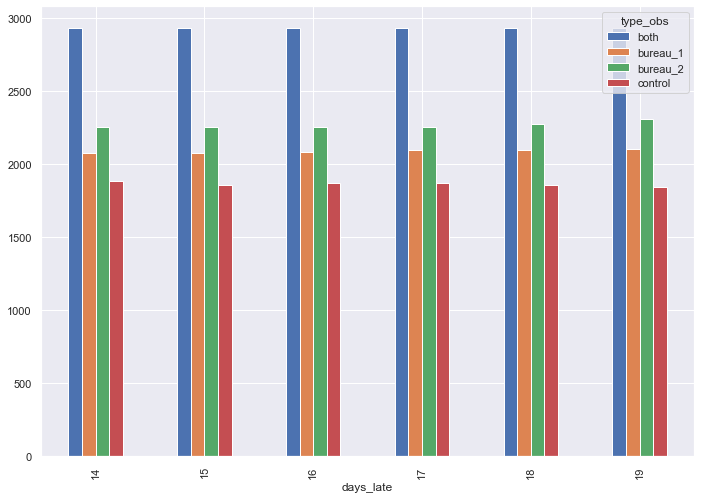

credit_limit_utilization


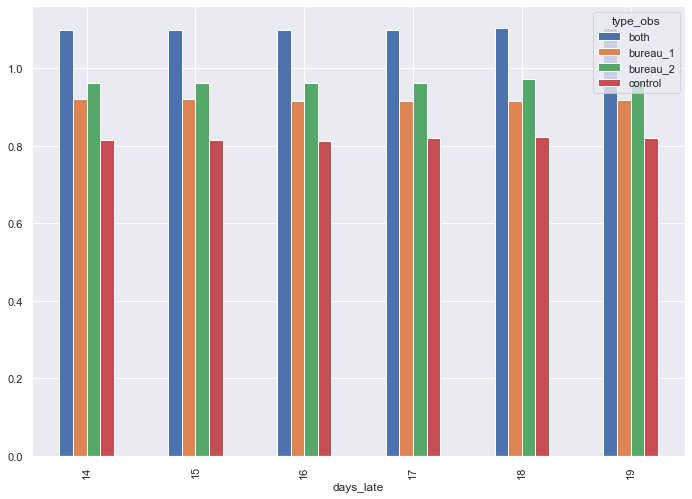

sum_spends_360


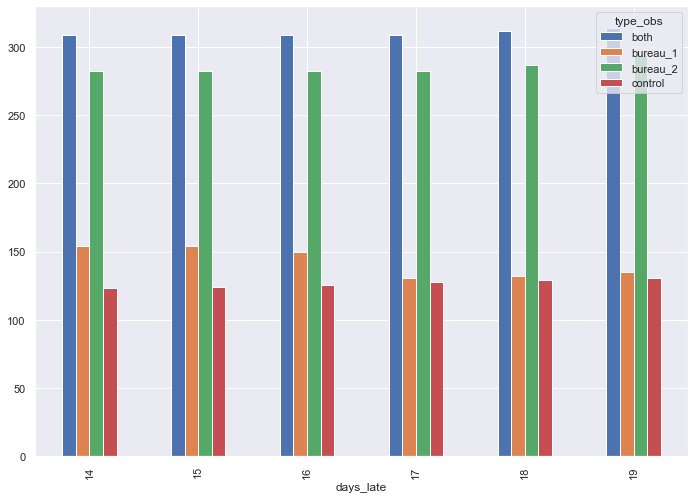

type_obs


In [124]:
for i in base.columns:
    try:
        print(i)
        groupavgs[groupavgs.index.isin([14,15,16,17,18,19])].fillna(0)[i].plot(kind='bar')







        plt.show()
    except:
        continue

In [125]:
groupmean=groupmean.unstack()

id
date
collections_start
days_late
bureau_1


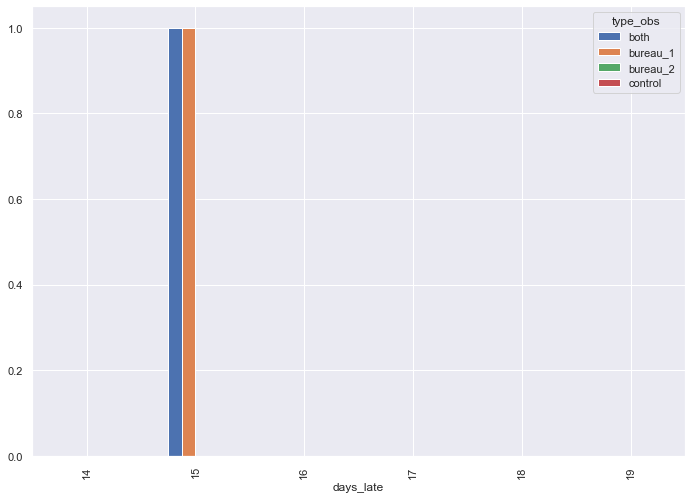

bureau_2


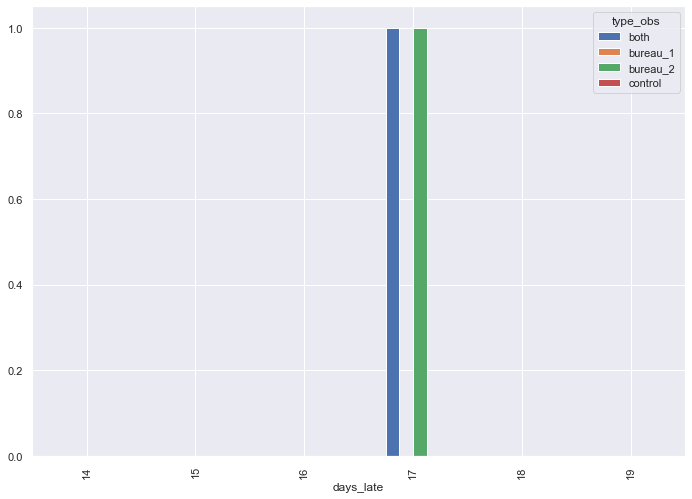

late_payments


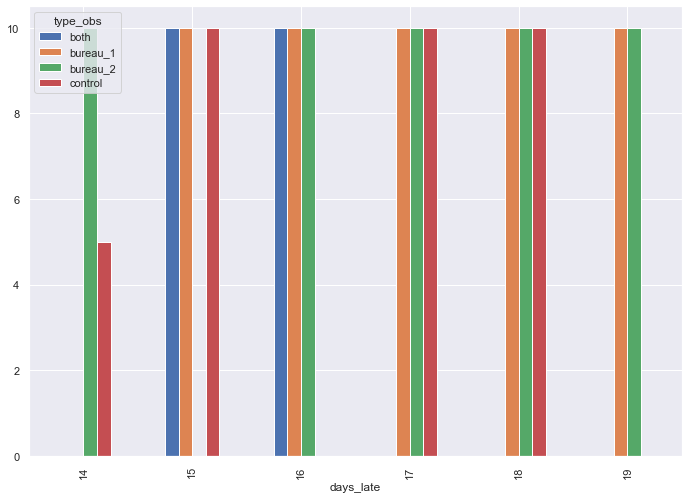

collection__end
std_revolving_balance_30


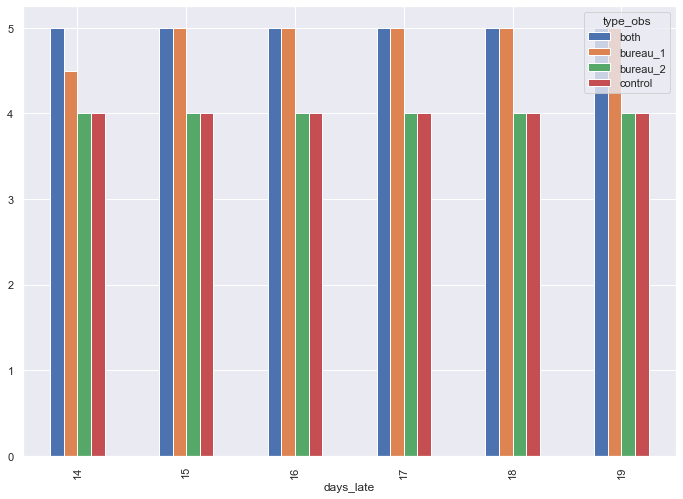

agreement_amount_mean


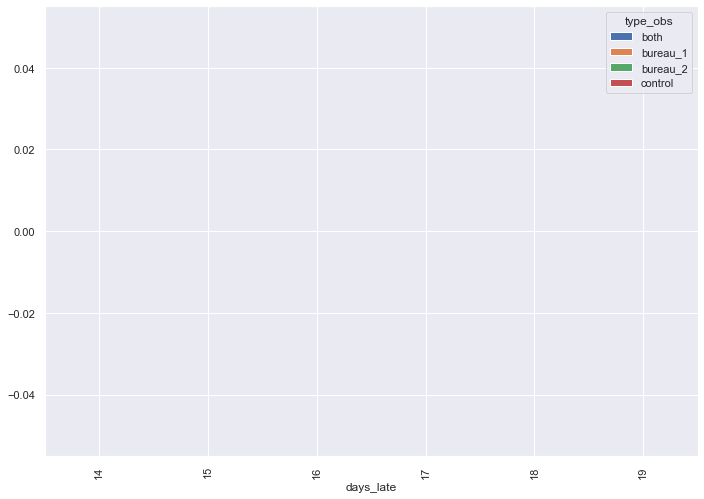

oustanting_balance_weight_30


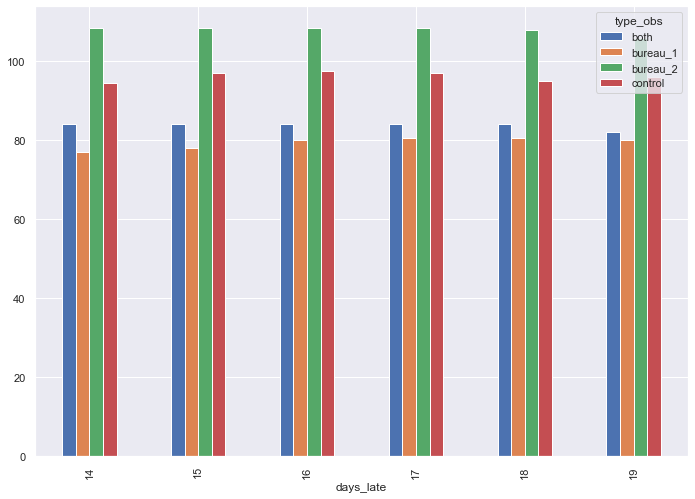

oustanting_balance_weight_90


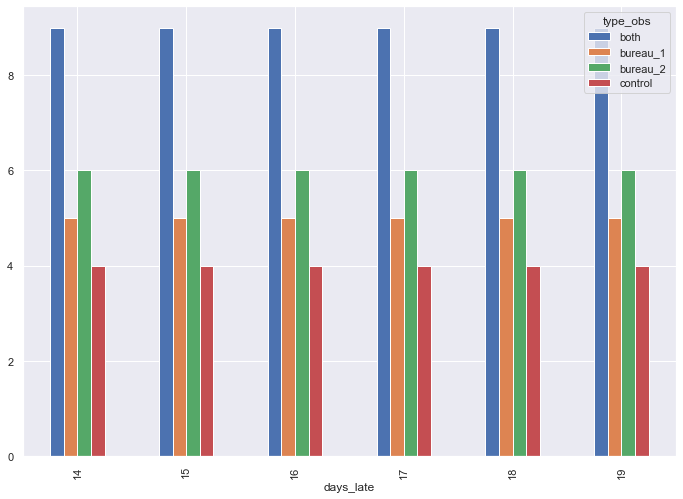

max_installments_balance_90


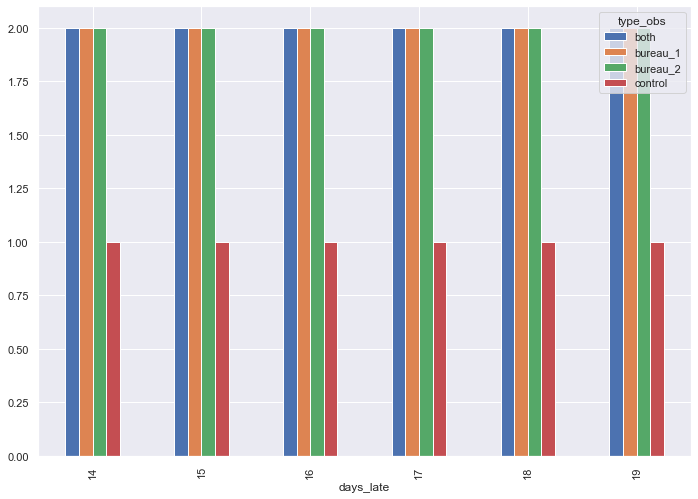

max_payment_90


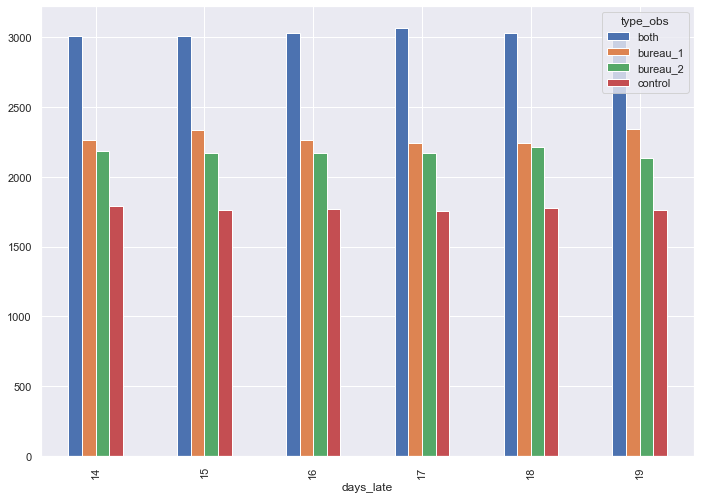

sum_limit_request_time_weight_180


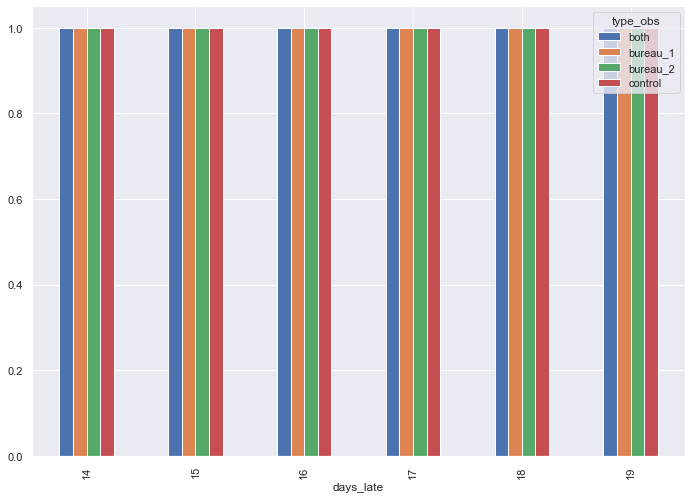

loss_balance


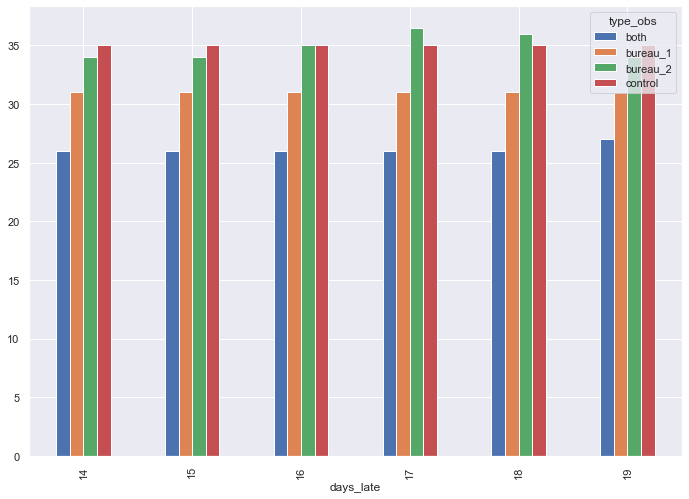

avg_late_balance_0_180


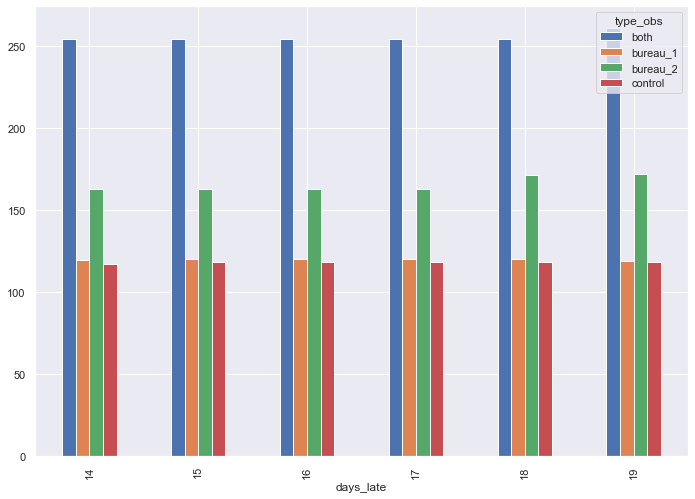

email_event_30


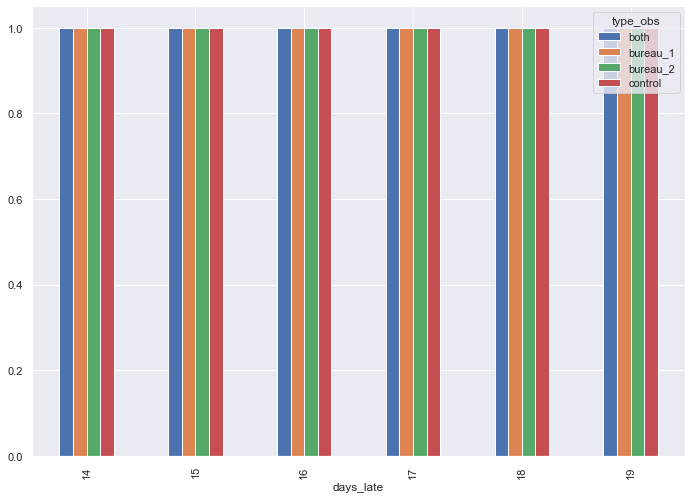

count_inbound_call_inbound_30


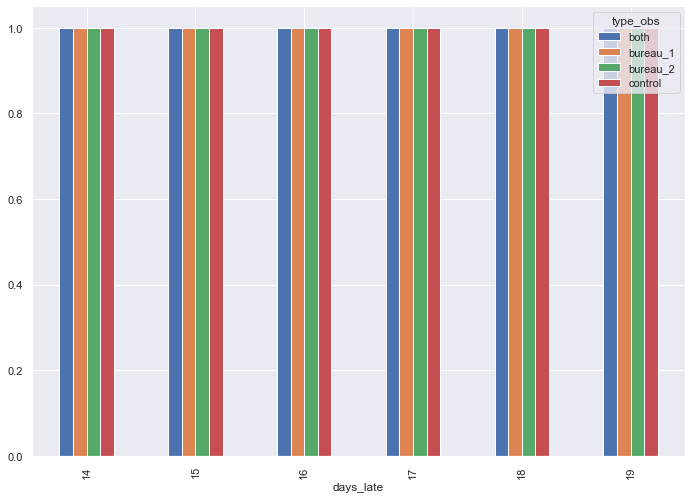

avg_call_duration_30


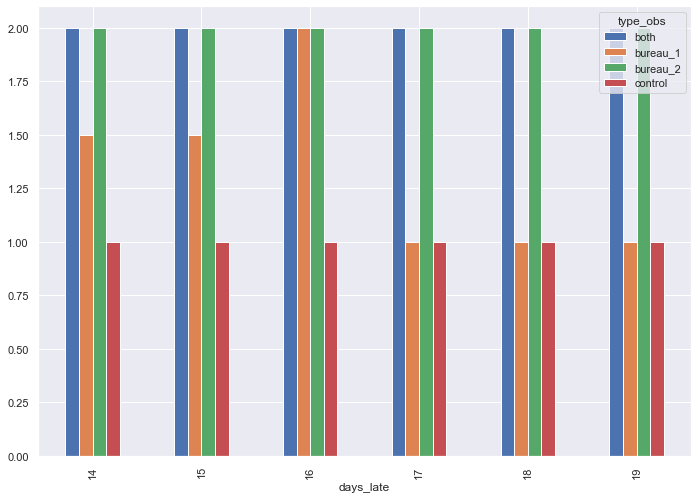

avg_installments_balance_30


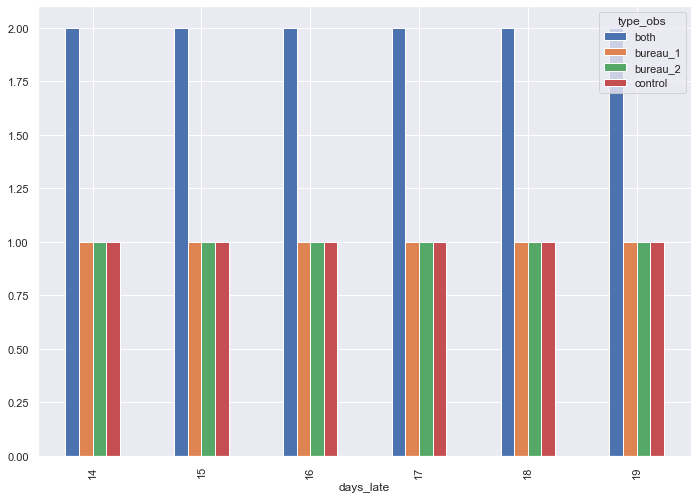

charges_agreement_mean


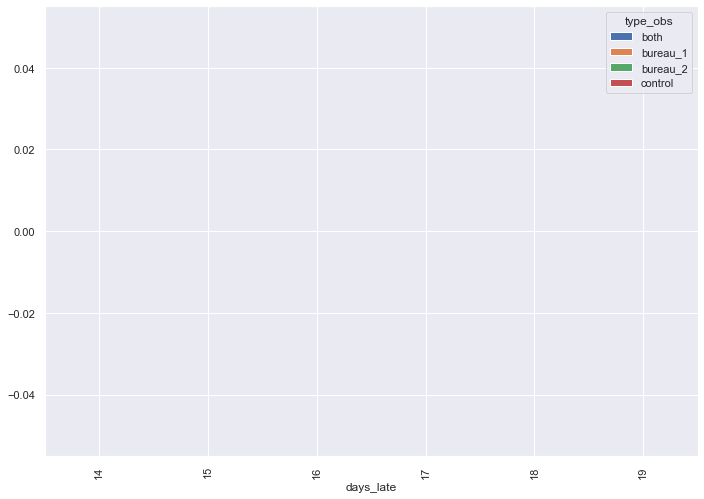

ongoing_agreement_amount


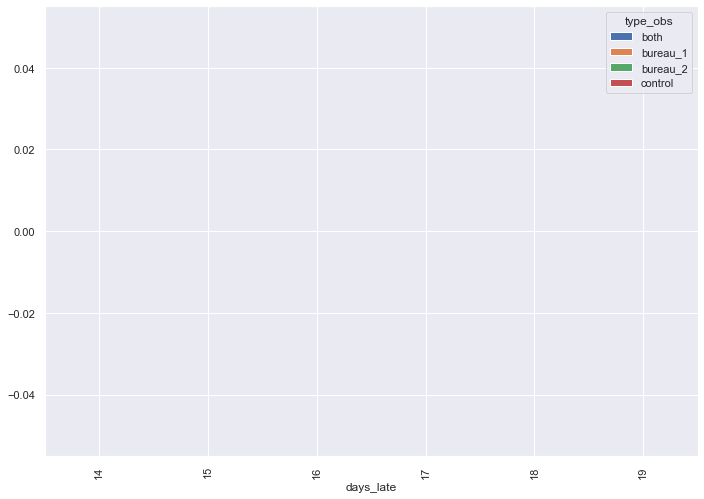

asset_late_balance


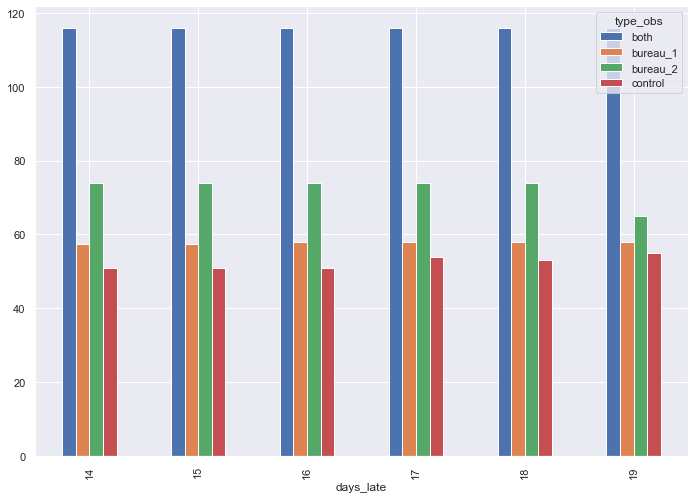

ongoing_agreement_downpayment


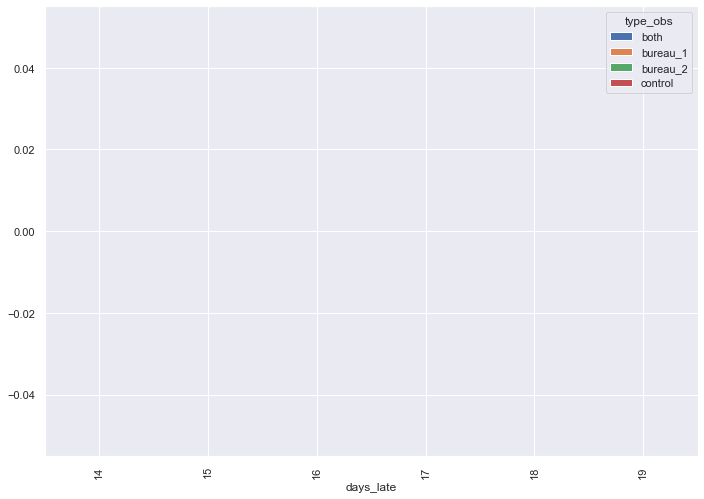

recovery_balance


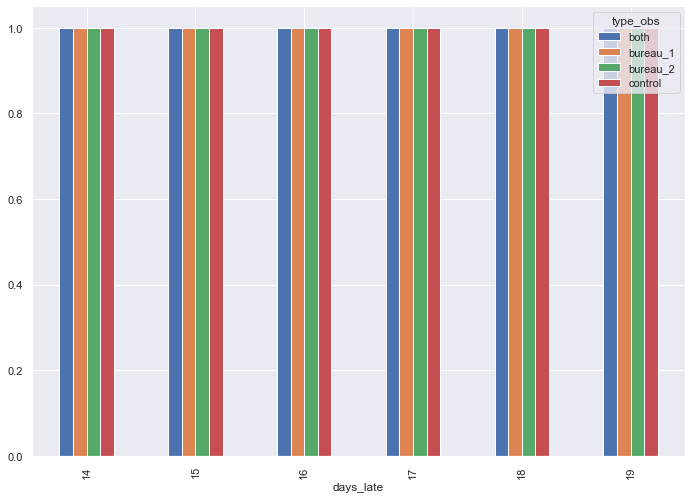

std_installments_balance_0_90


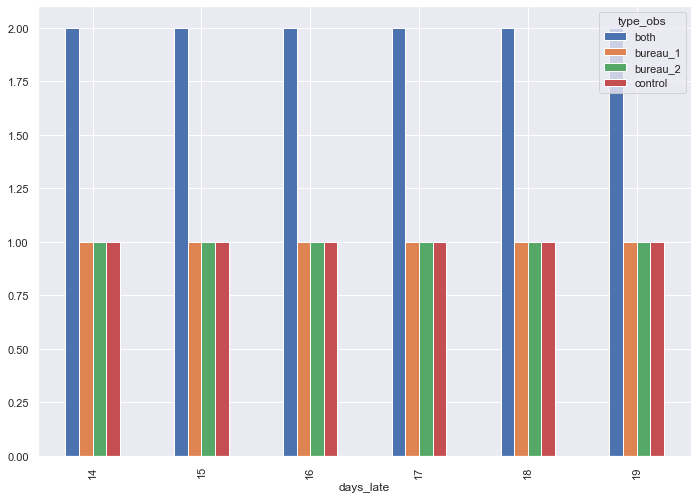

last_email_engagement


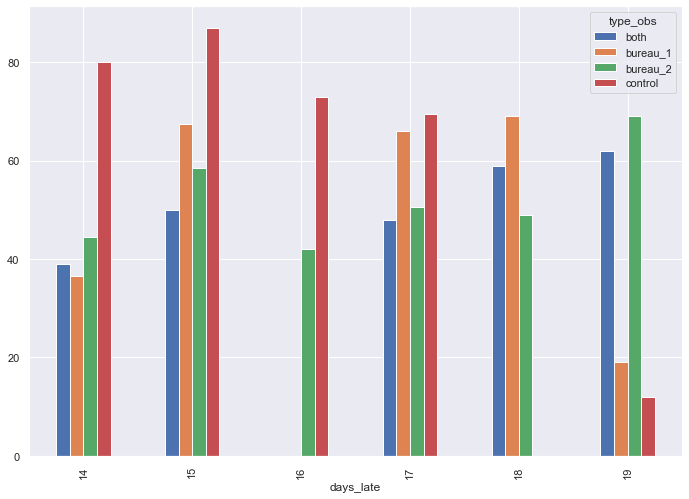

last_chat_engagement


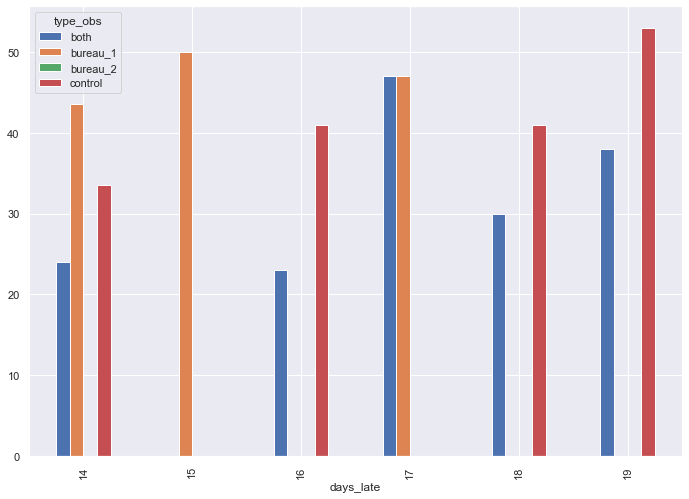

finantial_institutions


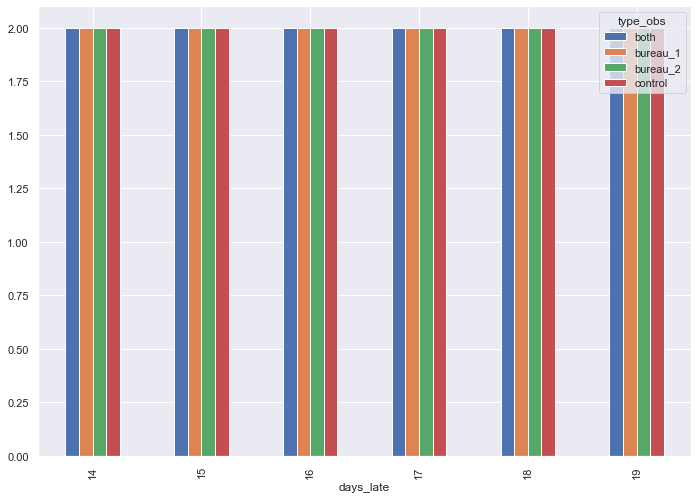

downpayment_mean


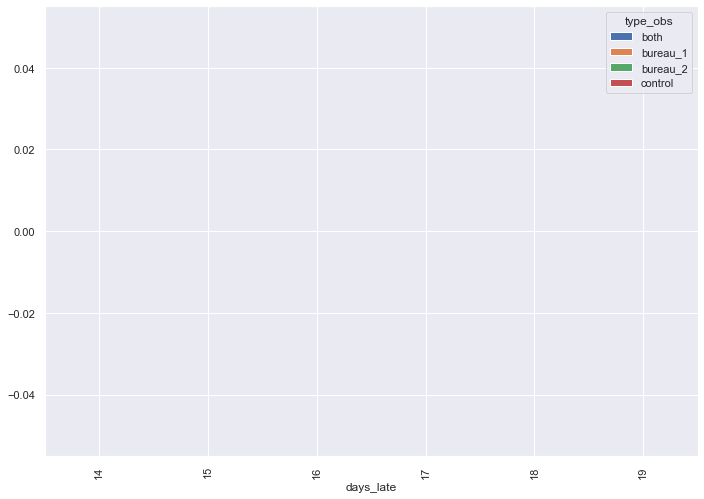

avg_spends


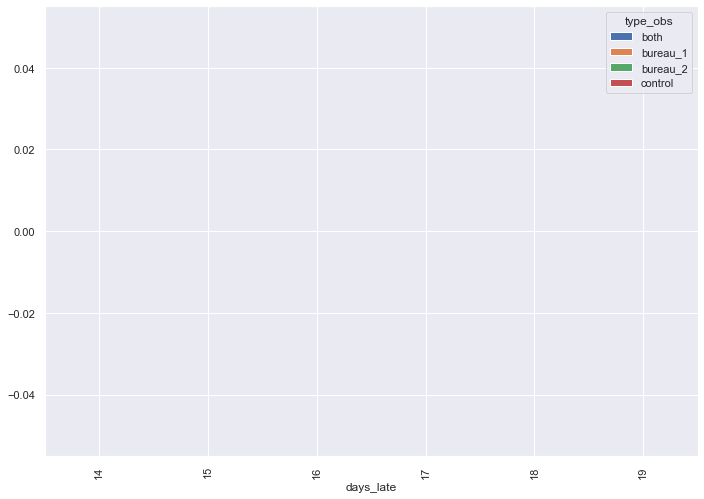

score_1


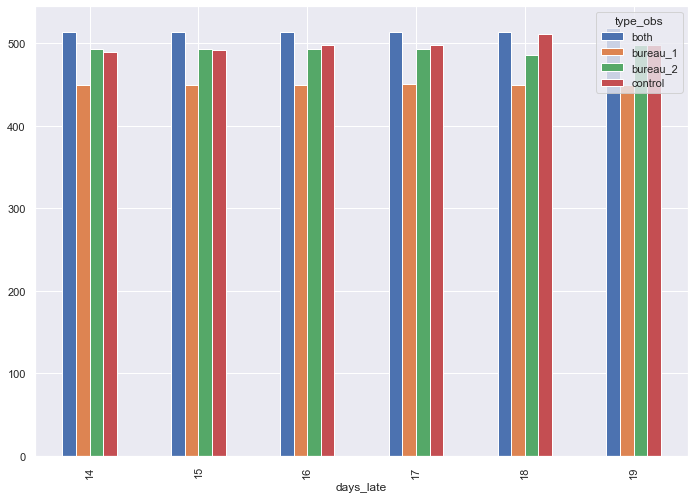

score_2


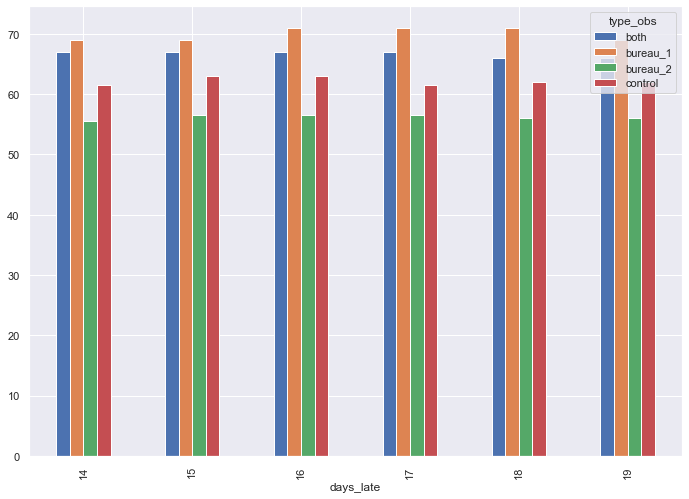

score_3


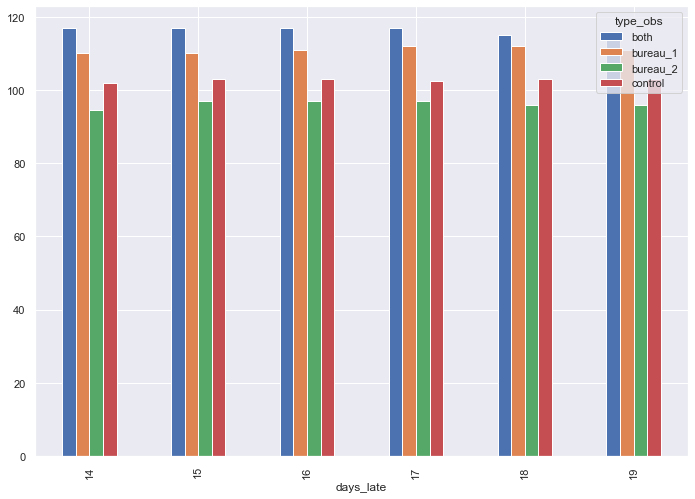

income_score_1


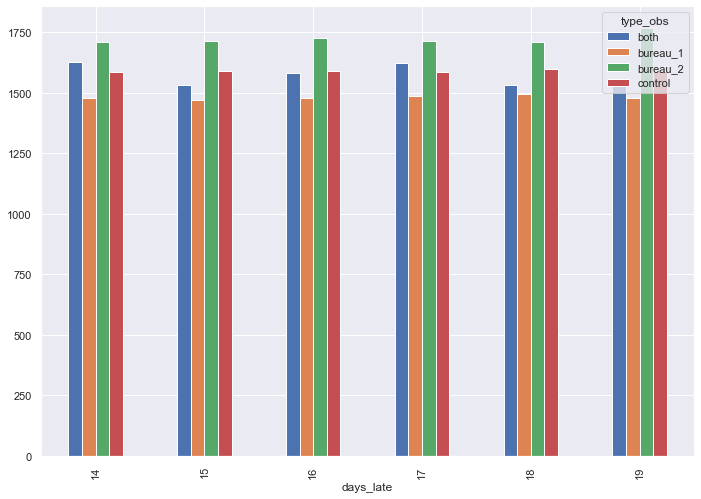

count_previous_delinquencies


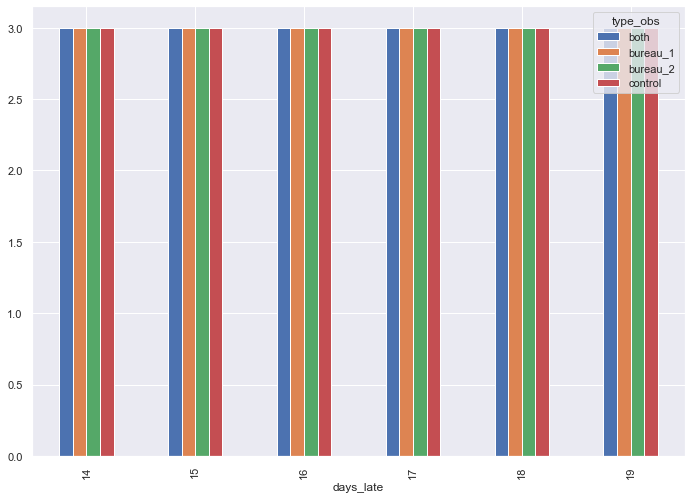

income_score_2


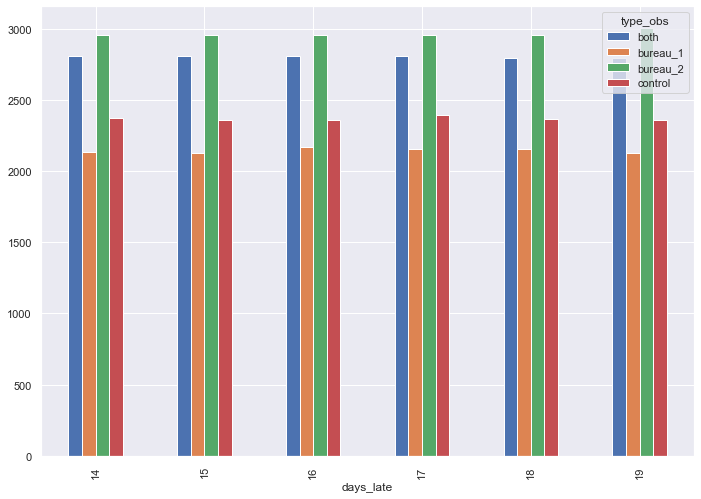

age


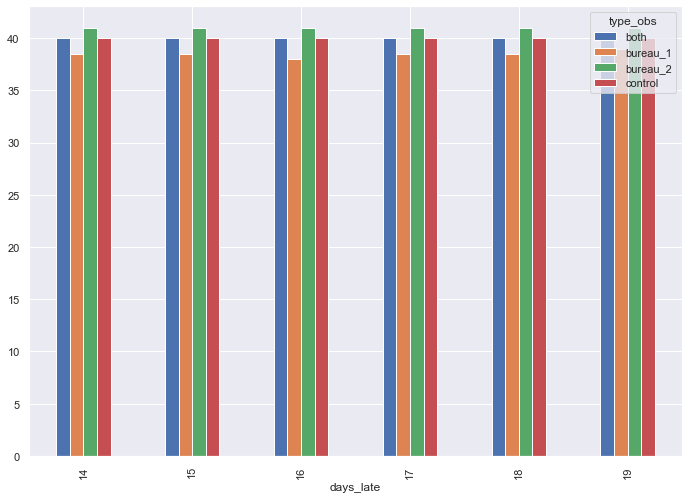

mean_previous_delinquencies_amount_weight_180


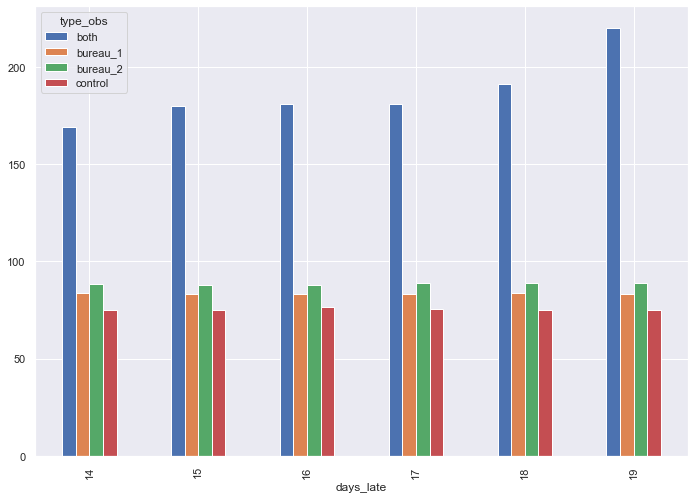

mean_previous_delinquencies_duration_90


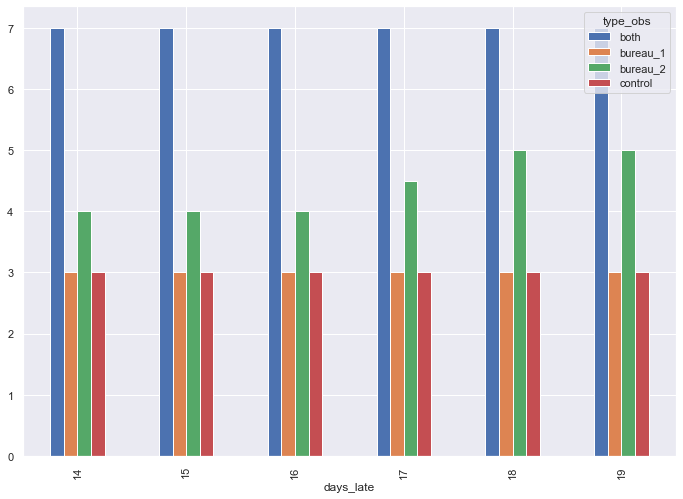

score_max_credit_limit


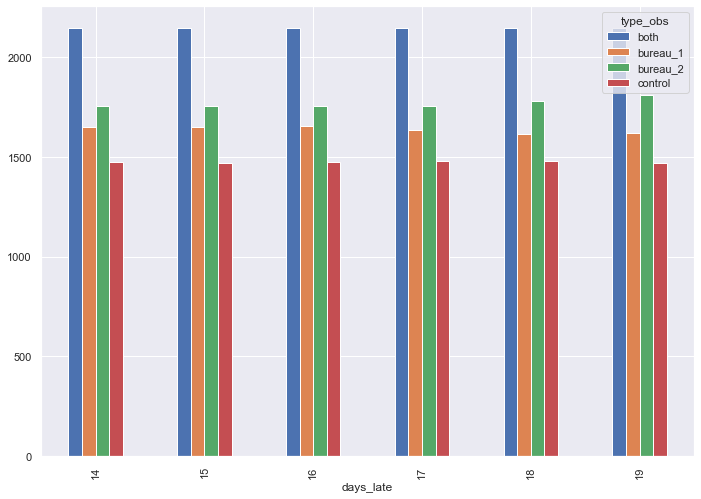

credit_limit_utilization


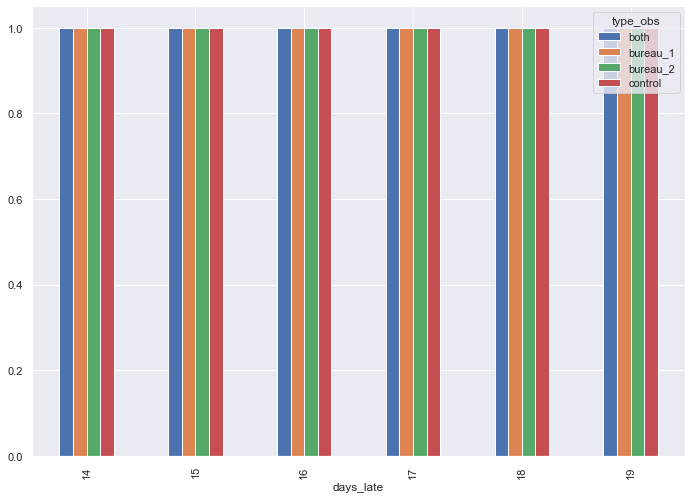

sum_spends_360


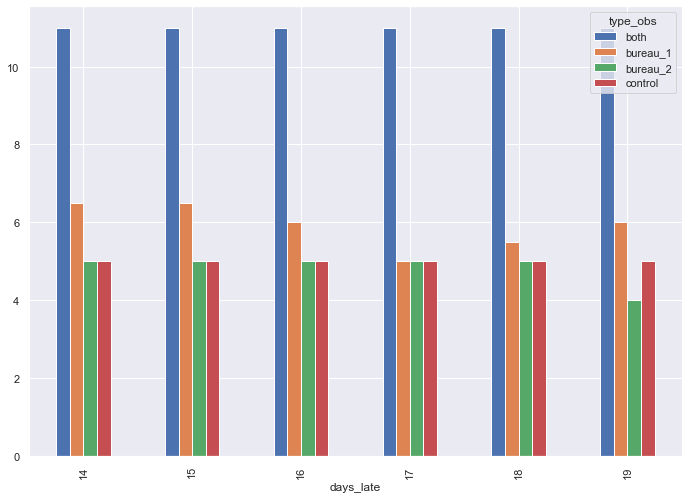

type_obs


In [126]:
for i in base.columns:
    try:
        print(i)
        groupmean[groupmean.index.isin([14,15,16,17,18,19])].fillna(0)[i].plot(kind='bar')







        plt.show()
    except:
        continue

In [95]:
g=base.drop(['id','date','collections_start'
            ,'collection__end'],axis=1).melt(['type_obs','days_late'])

In [96]:
g=g[(g['days_late'].isin([1,15,16,17,30]))]

In [79]:
from matplotlib import rcParams
rcParams['figure.figsize'] = 11.7,8.27

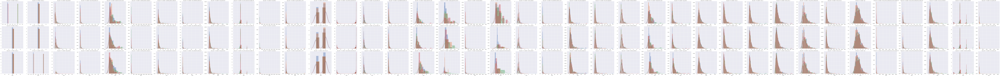

In [97]:

g1 = sns.FacetGrid(g  ,sharex=False,sharey=False,height=6
    
    
    , col='variable', hue="type_obs",row='days_late')
g1= (g1.map(sns.distplot, 'value'))

In [100]:
g1.add_legend()

In [101]:
g1.savefig("output.png")

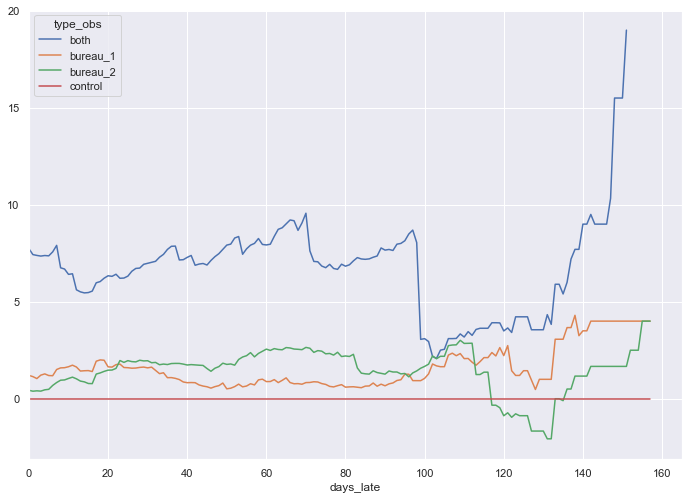

In [427]:
groupavgs['std_revolving_balance_30'].sub(groupavgs[('std_revolving_balance_30','control')],axis=0).plot()

In [439]:
base[base['id']=='7bf6a4ff-7be0-496c-9a0b-9c2b6aa7fe2c'].sort_values('days_late











',ascending=False)

,id,date,collections_start,days_late,bureau_1,bureau_2,late_payments,collection__end,std_revolving_balance_30,agreement_amount_mean,oustanting_balance_weight_30,oustanting_balance_weight_90,max_installments_balance_90,max_payment_90,sum_limit_request_time_weight_180,loss_balance,avg_late_balance_0_180,email_event_30,count_inbound_call_inbound_30,avg_call_duration_30,avg_installments_balance_30,charges_agreement_mean,ongoing_agreement_amount,asset_late_balance,ongoing_agreement_downpayment,recovery_balance,std_installments_balance_0_90,last_email_engagement,last_chat_engagement,finantial_institutions,downpayment_mean,avg_spends,score_1,score_2,score_3,income_score_1,count_previous_delinquencies,income_score_2,age,mean_previous_delinquencies_amount_weight_180,mean_previous_delinquencies_duration_90,score_max_credit_limit,credit_limit_utilization,sum_spends_360,type_obs,collection_time
53544,7bf6a4ff-7be0-496c-9a0b-9c2b6aa7fe2c,2017-06-15,2017-05-15,31,0,0,0,NaT,12.0,NaN,20.0,67.0,6.0,5253.0,1.0,29.0,1842.0,1.0,1.0,5.0,4.0,NaN,NaN,66185.0,NaN,1.0,4.0,NaN,68.0,0.0,NaN,NaN,1394.0,6.0,24.0,2086.0,4.0,5679.0,41.0,4988.0,161.0,1587.0,3.0,3226.0,both,NaT
53094,7bf6a4ff-7be0-496c-9a0b-9c2b6aa7fe2c,2017-06-14,2017-05-15,30,0,0,0,NaT,12.0,NaN,20.0,67.0,6.0,5253.0,1.0,29.0,1303.0,1.0,1.0,5.0,4.0,NaN,NaN,66185.0,NaN,1.0,4.0,123.0,NaN,0.0,NaN,40.0,1394.0,6.0,24.0,2086.0,4.0,5679.0,41.0,4988.0,161.0,1587.0,3.0,3226.0,both,NaT
52635,7bf6a4ff-7be0-496c-9a0b-9c2b6aa7fe2c,2017-06-13,2017-05-15,29,0,0,0,NaT,12.0,NaN,20.0,67.0,6.0,5253.0,1.0,29.0,1303.0,1.0,1.0,5.0,4.0,NaN,NaN,66185.0,NaN,1.0,4.0,NaN,NaN,0.0,NaN,NaN,1394.0,6.0,24.0,2086.0,4.0,5679.0,41.0,4988.0,177.0,1587.0,3.0,3226.0,both,NaT
52170,7bf6a4ff-7be0-496c-9a0b-9c2b6aa7fe2c,2017-06-12,2017-05-15,28,0,0,0,NaT,12.0,NaN,20.0,67.0,6.0,5253.0,1.0,29.0,1303.0,1.0,1.0,5.0,4.0,NaN,NaN,66185.0,NaN,1.0,4.0,123.0,NaN,0.0,NaN,40.0,1394.0,6.0,24.0,2086.0,4.0,5679.0,41.0,4988.0,177.0,1587.0,3.0,3226.0,both,NaT
51704,7bf6a4ff-7be0-496c-9a0b-9c2b6aa7fe2c,2017-06-11,2017-05-15,27,0,0,0,NaT,12.0,NaN,20.0,67.0,6.0,5253.0,1.0,29.0,1303.0,1.0,1.0,5.0,4.0,NaN,NaN,66185.0,NaN,1.0,4.0,123.0,NaN,0.0,NaN,NaN,1394.0,6.0,24.0,2086.0,4.0,5679.0,41.0,4988.0,177.0,1587.0,3.0,3226.0,both,NaT
51243,7bf6a4ff-7be0-496c-9a0b-9c2b6aa7fe2c,2017-06-10,2017-05-15,26,0,0,0,NaT,12.0,NaN,20.0,67.0,6.0,5253.0,1.0,29.0,1303.0,1.0,1.0,5.0,4.0,NaN,NaN,66185.0,NaN,1.0,4.0,123.0,NaN,0.0,NaN,NaN,1394.0,6.0,24.0,2086.0,4.0,5679.0,41.0,4988.0,177.0,1587.0,3.0,3226.0,both,NaT
50783,7bf6a4ff-7be0-496c-9a0b-9c2b6aa7fe2c,2017-06-09,2017-05-15,25,0,0,10,NaT,12.0,NaN,20.0,67.0,6.0,5083.0,1.0,29.0,1303.0,1.0,1.0,5.0,4.0,NaN,NaN,66185.0,NaN,1.0,4.0,123.0,67.0,0.0,NaN,40.0,1394.0,6.0,24.0,2086.0,4.0,5679.0,41.0,4260.0,177.0,1587.0,3.0,3226.0,both,NaT
50320,7bf6a4ff-7be0-496c-9a0b-9c2b6aa7fe2c,2017-06-08,2017-05-15,24,0,0,20,NaT,12.0,NaN,20.0,67.0,6.0,5083.0,1.0,29.0,1303.0,1.0,1.0,5.0,4.0,NaN,NaN,66185.0,NaN,1.0,4.0,NaN,67.0,0.0,NaN,40.0,1394.0,6.0,24.0,2086.0,4.0,5679.0,41.0,4260.0,177.0,1587.0,3.0,3226.0,both,NaT
49859,7bf6a4ff-7be0-496c-9a0b-9c2b6aa7fe2c,2017-06-07,2017-05-15,23,0,0,10,NaT,12.0,NaN,20.0,67.0,6.0,5083.0,1.0,29.0,1303.0,1.0,1.0,5.0,4.0,NaN,NaN,66185.0,NaN,1.0,4.0,123.0,67.0,0.0,NaN,NaN,1394.0,6.0,24.0,2086.0,4.0,5679.0,41.0,4260.0,177.0,1587.0,3.0,3226.0,both,NaT
49397,7bf6a4ff-7be0-496c-9a0b-9c2b6aa7fe2c,2017-06-06,2017-05-15,22,0,0,0,NaT,12.0,NaN,20.0,67.0,6.0,5083.0,1.0,29.0,1303.0,1.0,1.0,5.0,4.0,NaN,NaN,66185.0,NaN,1.0,4.0,123.0,NaN,0.0,NaN,40.0,1394.0,6.0,24.0,2086.0,4.0,5679.0,41.0,4260.0,177.0,1587.0,3.0,3226.0,both,NaT


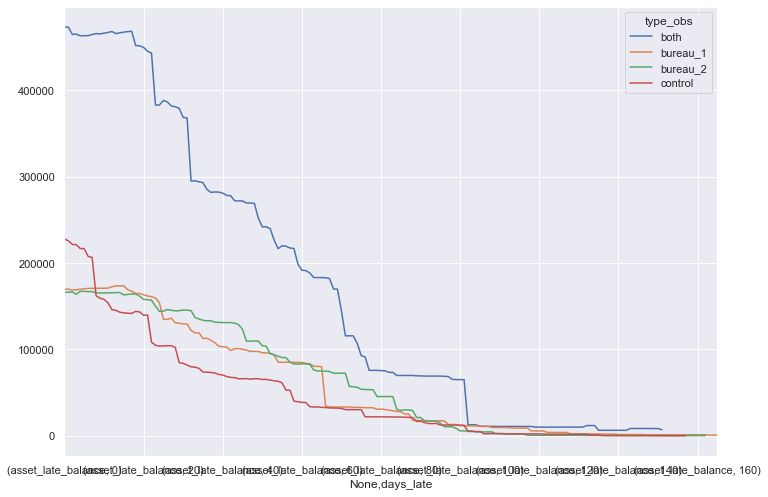

In [428]:
base[['days_late','asset_late_balance','type_obs']].fillna(0).groupby(['type_obs','days_late']).sum().unstack().T.plot()

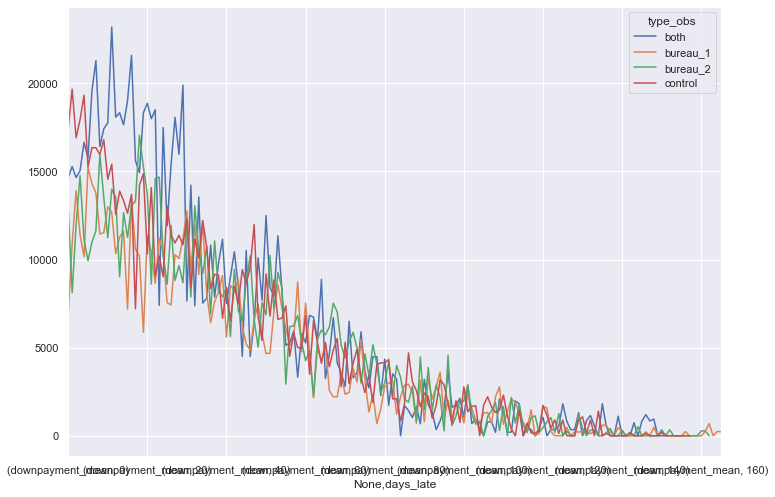

In [436]:
base[['days_late','downpayment_mean','type_obs']].fillna(0).groupby(['type_obs','days_late']).sum().unstack().T.plot()

In [287]:
groupavgs=groupavgs.unstack()

id
date
collections_start
days_late
bureau_1


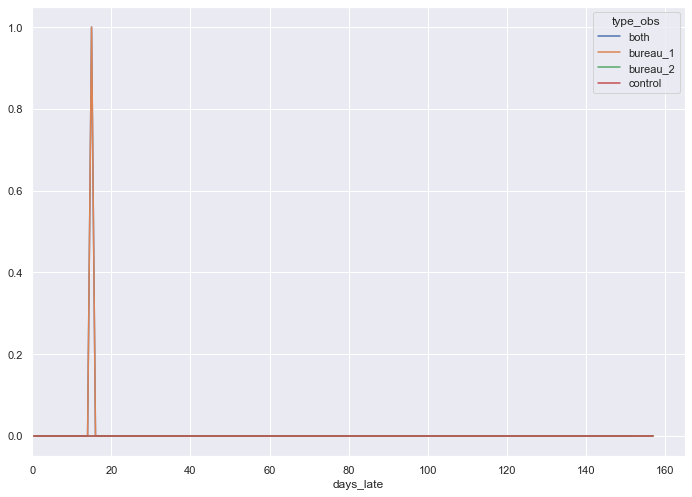

bureau_2


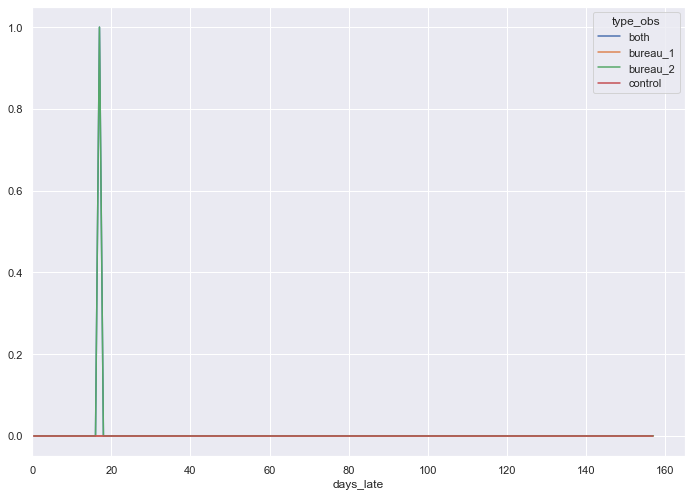

late_payments


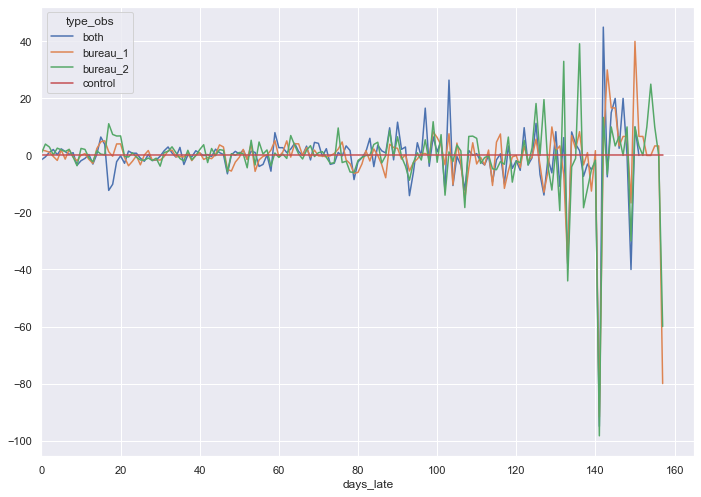

collection__end
std_revolving_balance_30


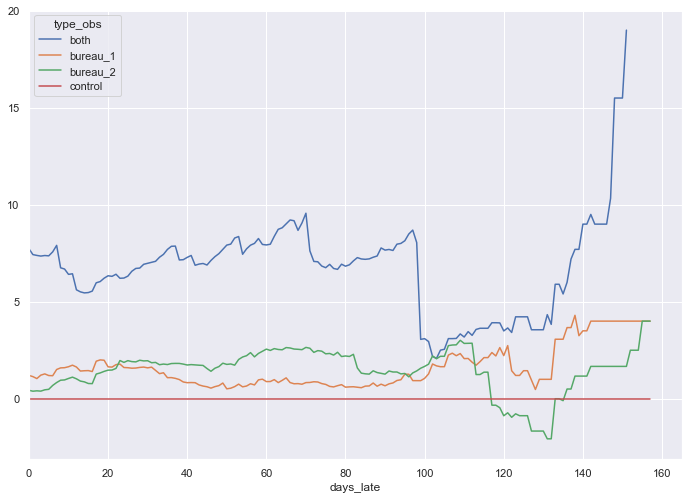

agreement_amount_mean


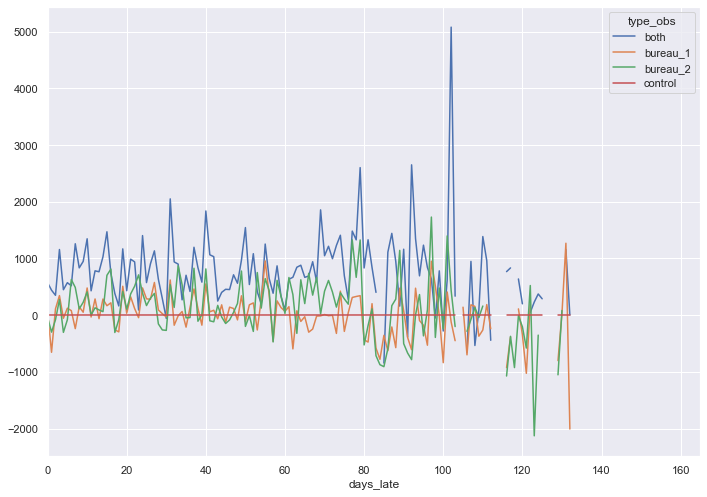

oustanting_balance_weight_30


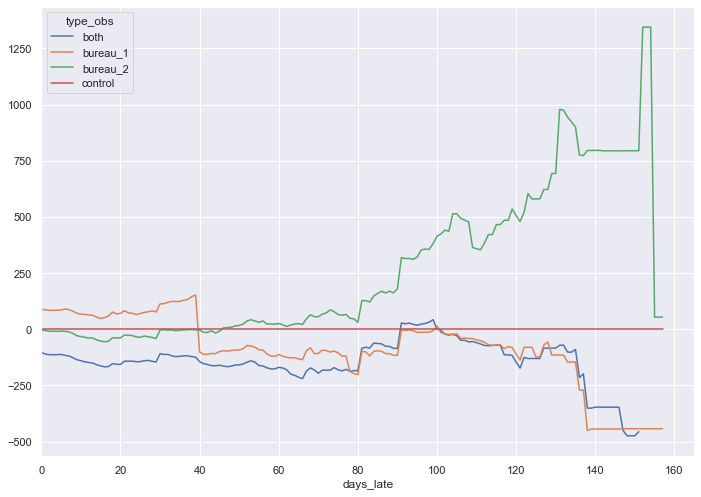

oustanting_balance_weight_90


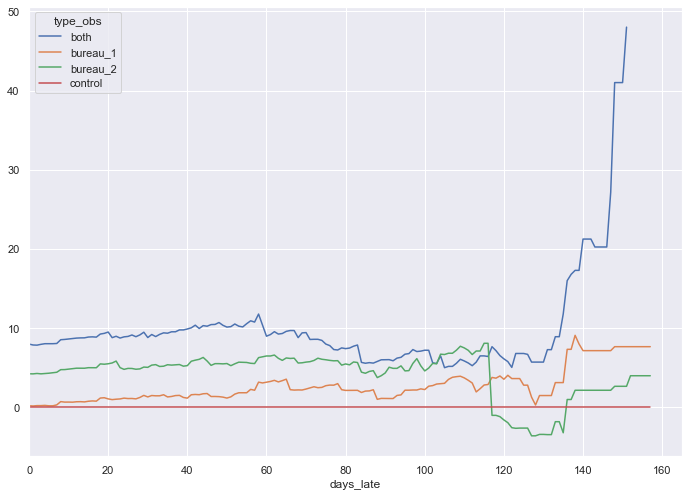

max_installments_balance_90


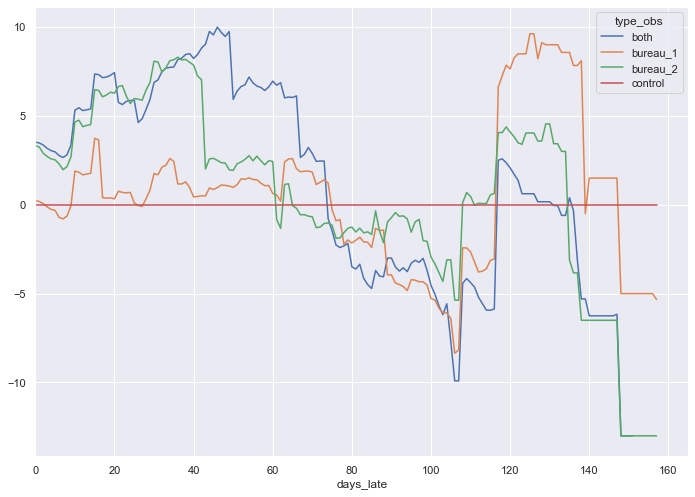

max_payment_90


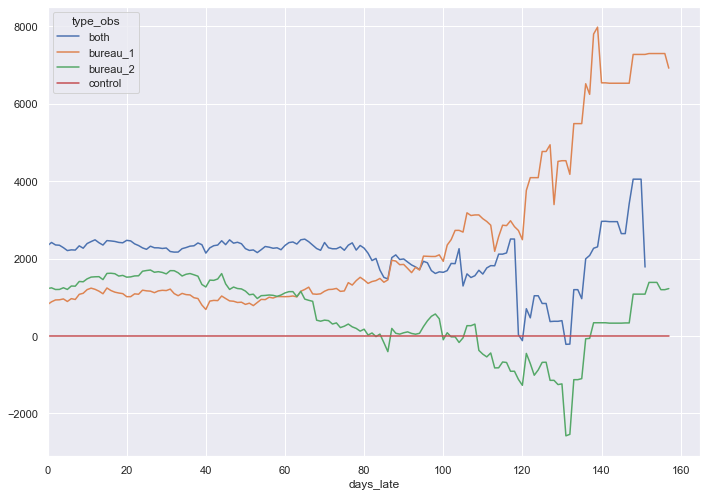

sum_limit_request_time_weight_180


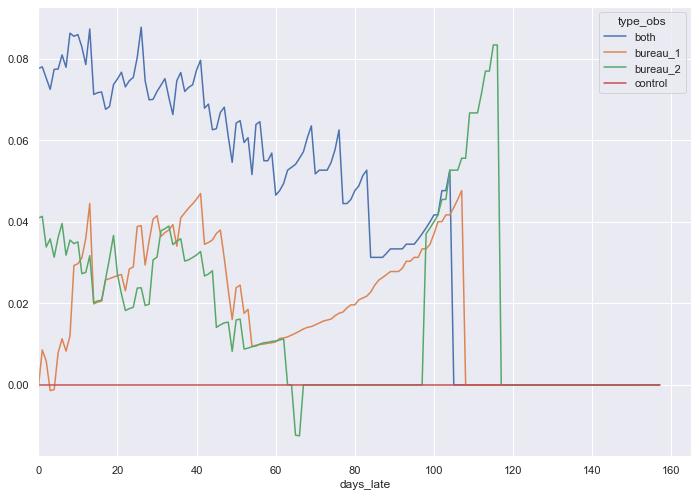

loss_balance


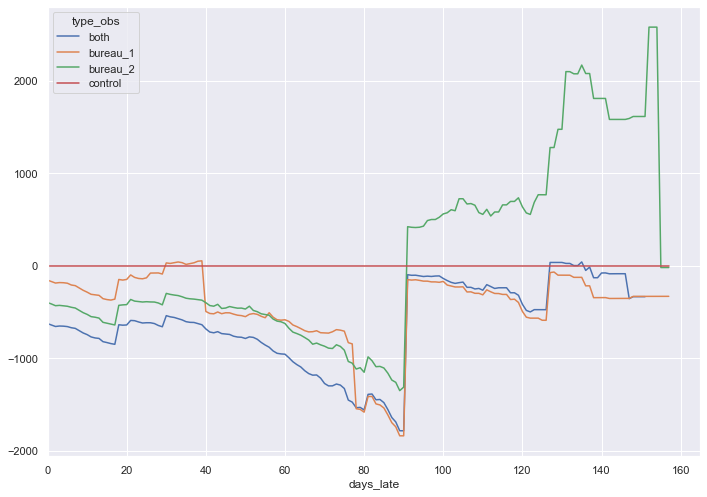

avg_late_balance_0_180


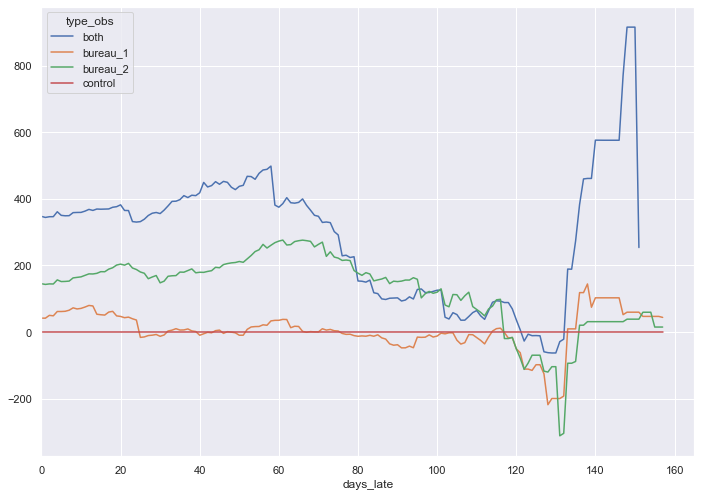

email_event_30


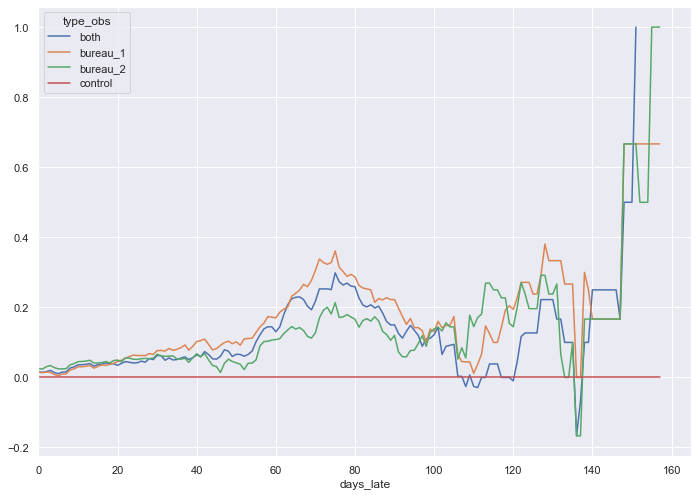

count_inbound_call_inbound_30


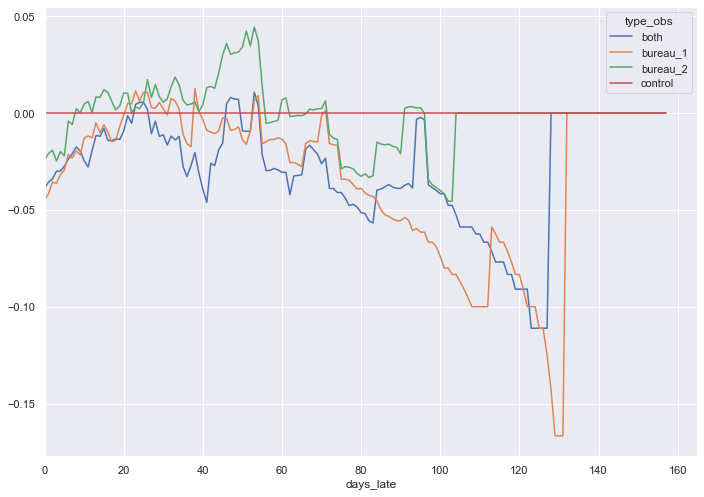

avg_call_duration_30


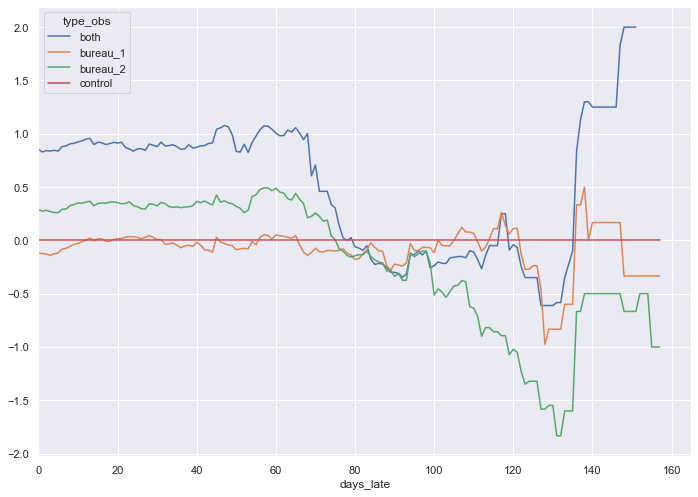

avg_installments_balance_30


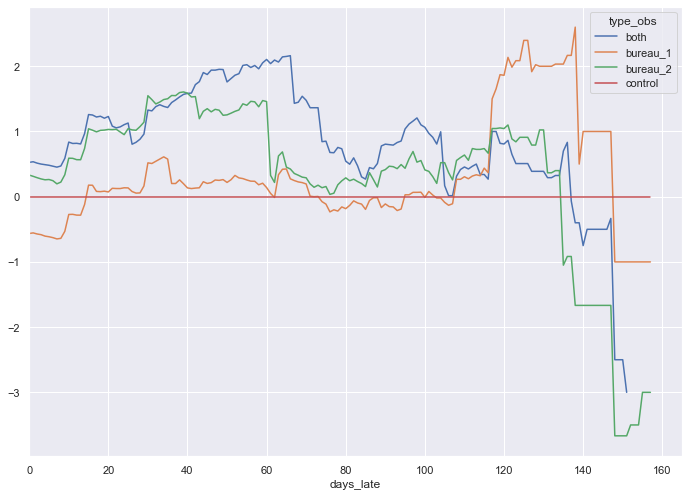

charges_agreement_mean


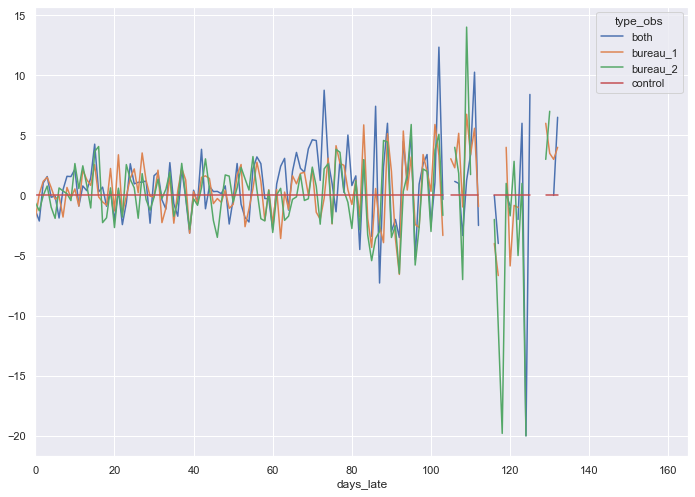

ongoing_agreement_amount


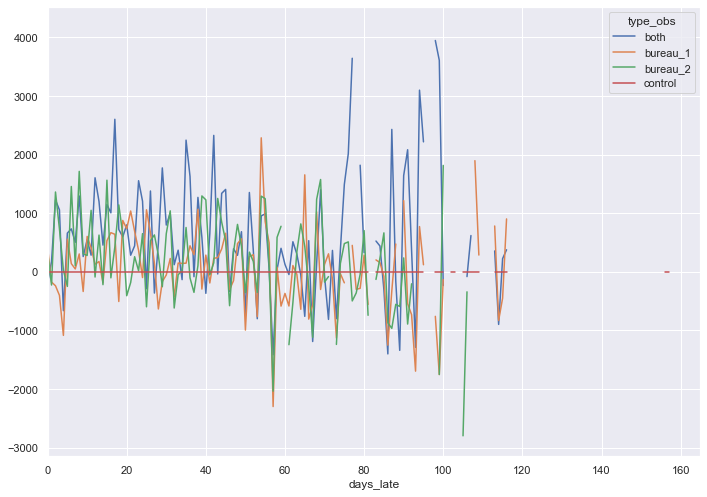

asset_late_balance


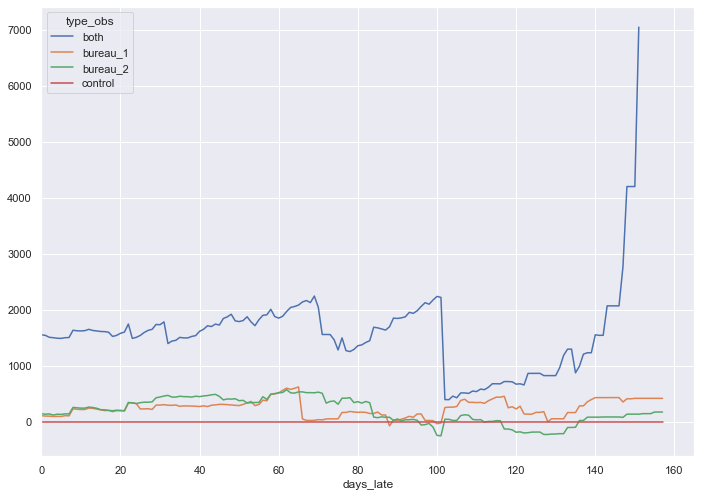

ongoing_agreement_downpayment


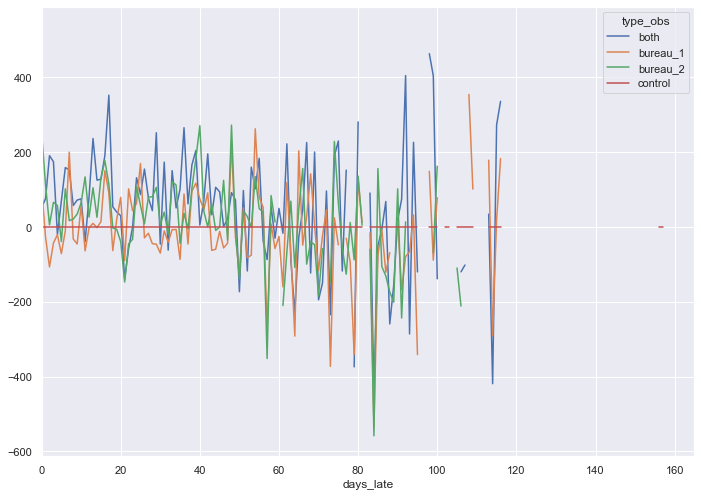

recovery_balance


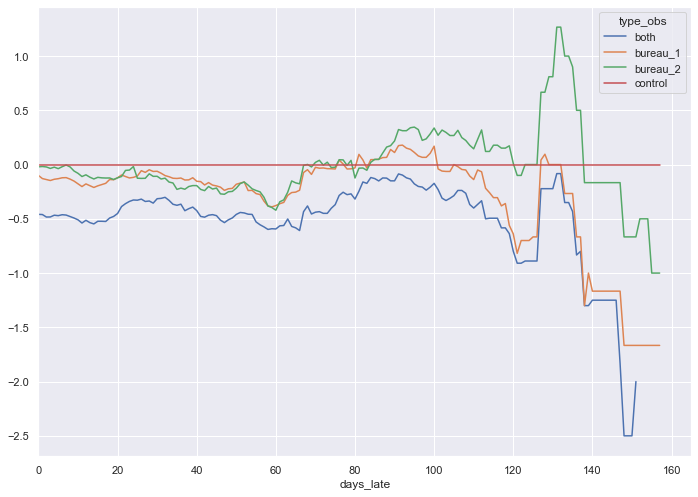

std_installments_balance_0_90


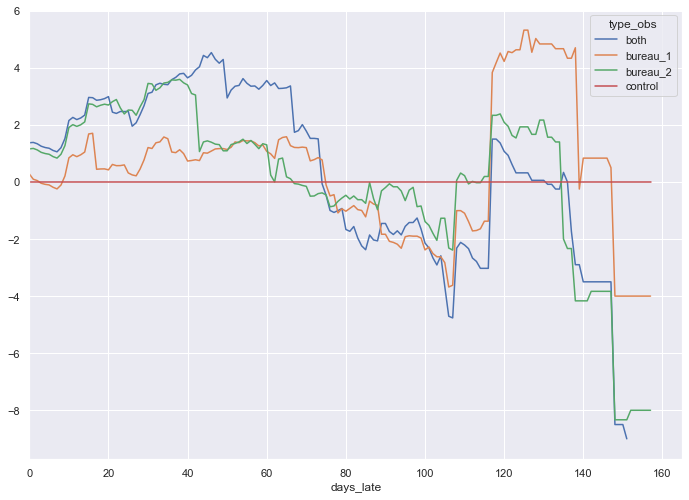

last_email_engagement


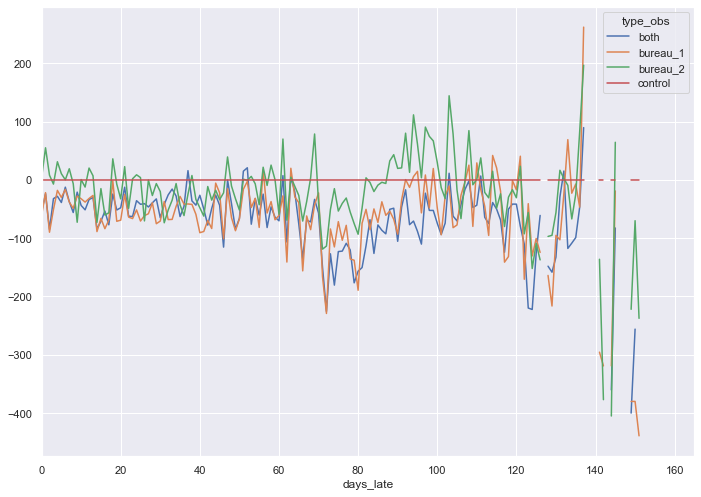

last_chat_engagement


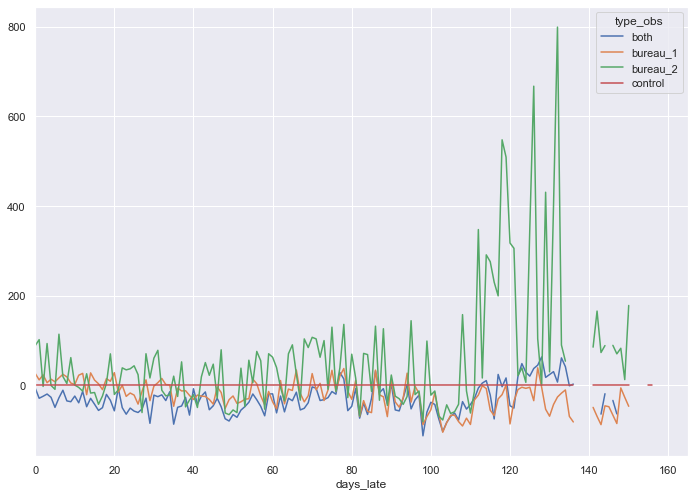

finantial_institutions


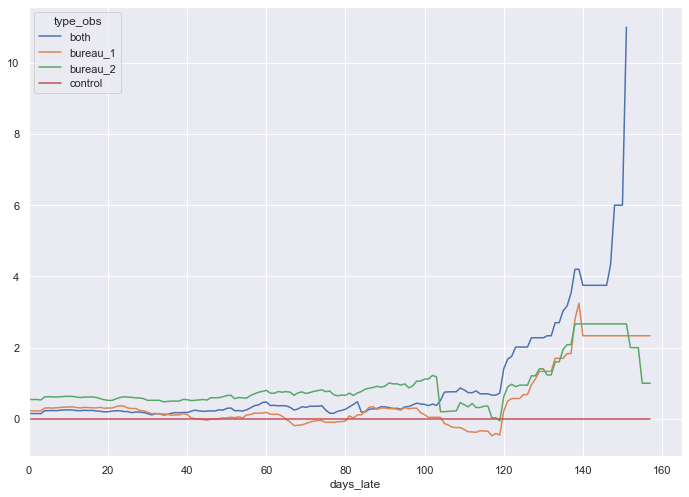

downpayment_mean


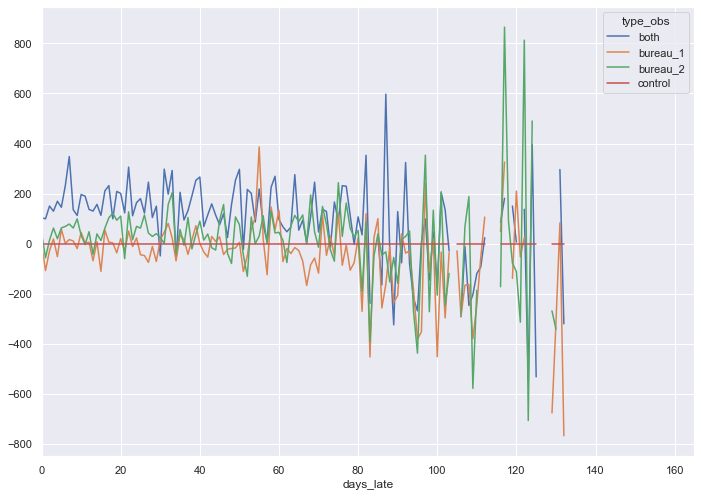

avg_spends


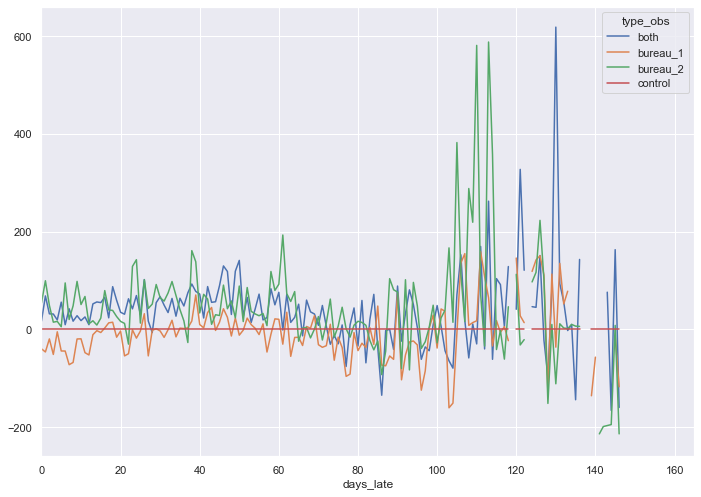

score_1


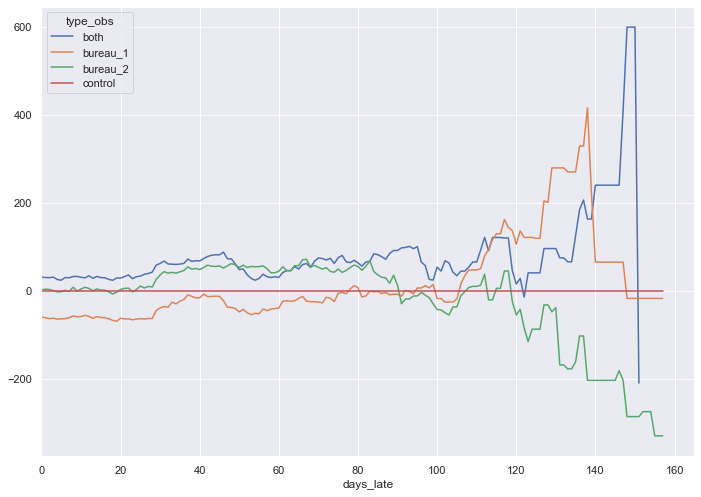

score_2


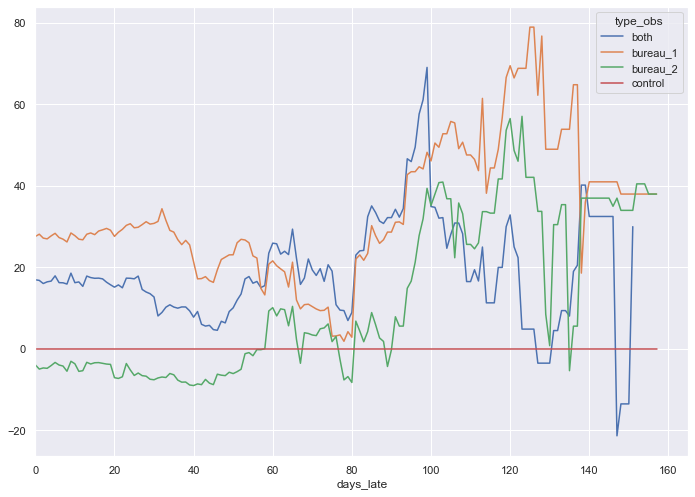

score_3


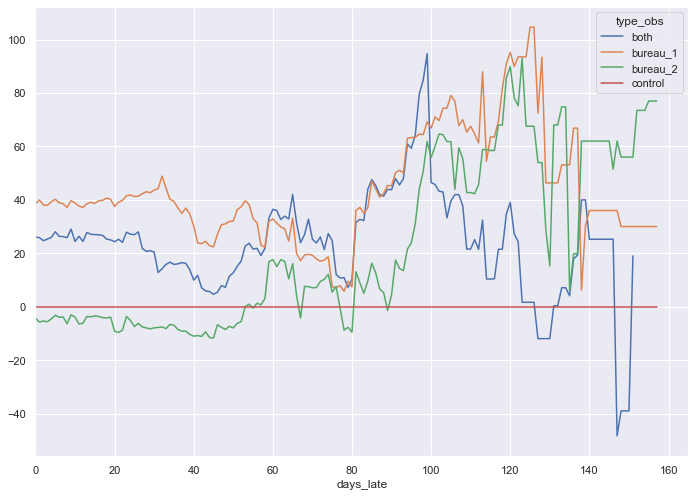

income_score_1


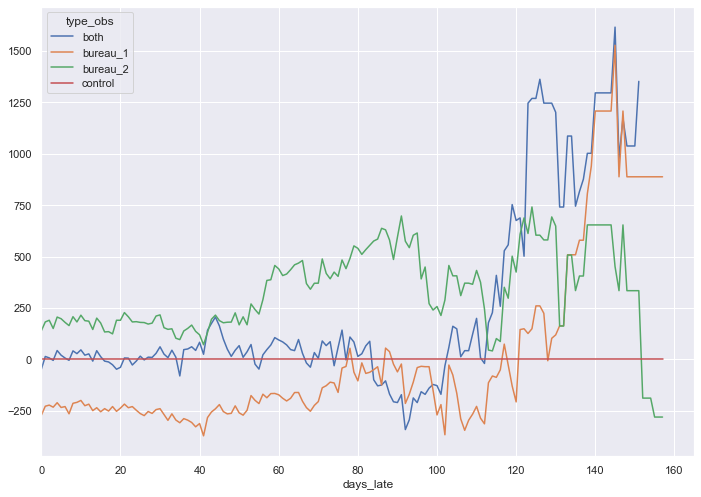

count_previous_delinquencies


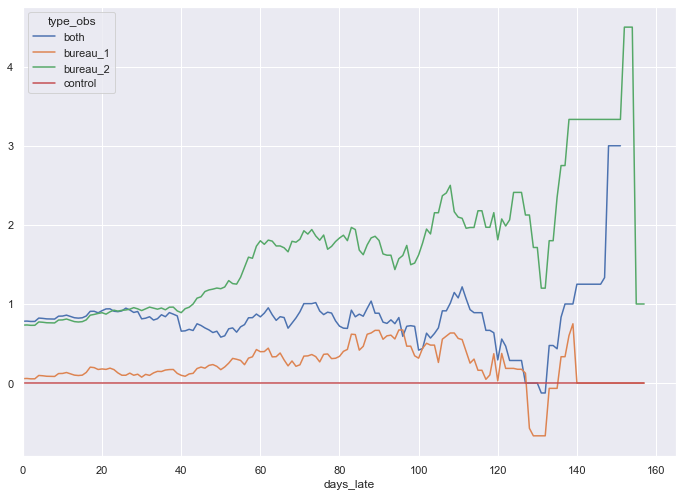

income_score_2


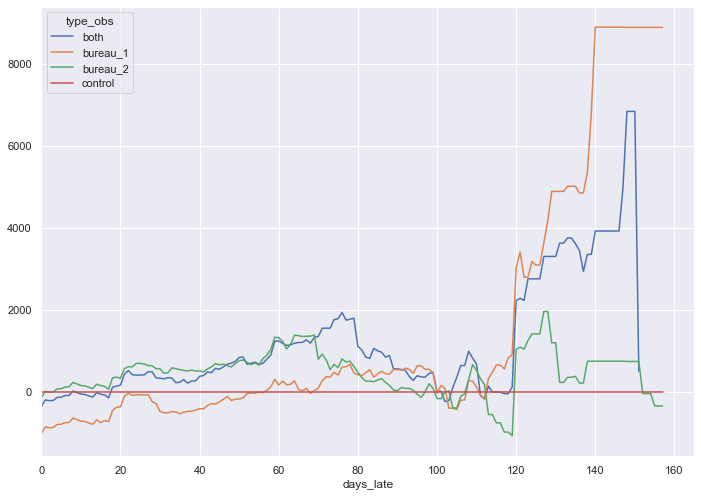

age


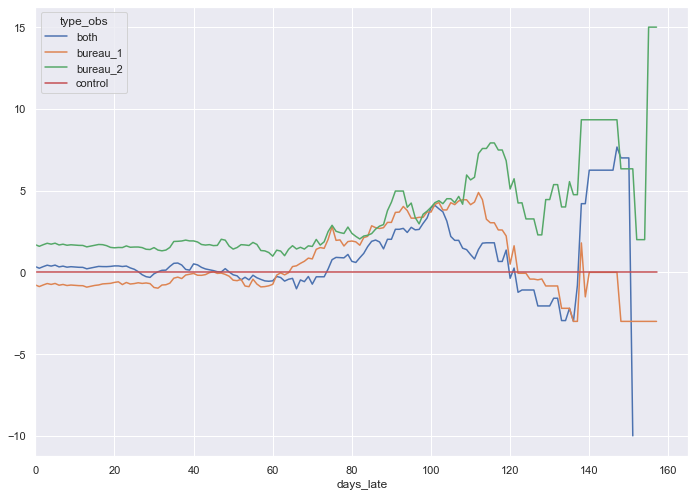

mean_previous_delinquencies_amount_weight_180


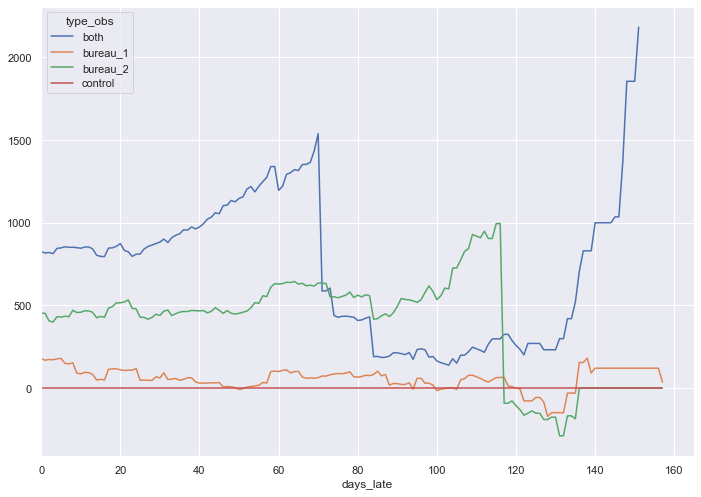

mean_previous_delinquencies_duration_90


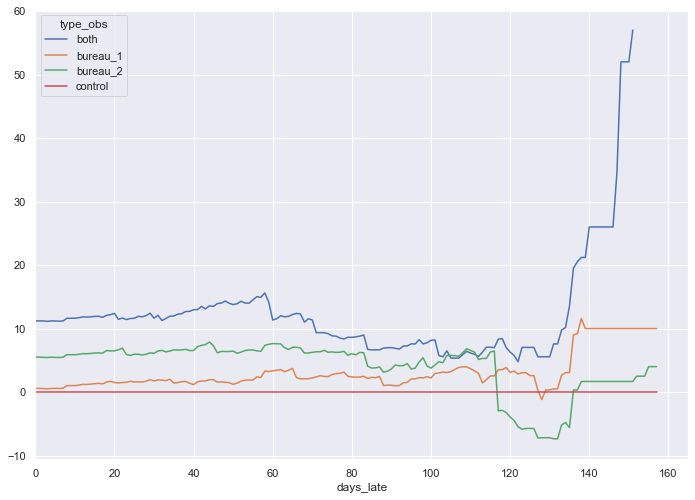

score_max_credit_limit


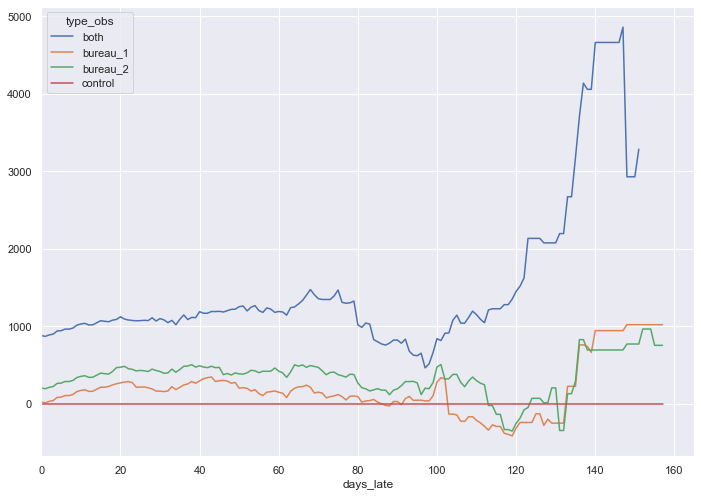

credit_limit_utilization


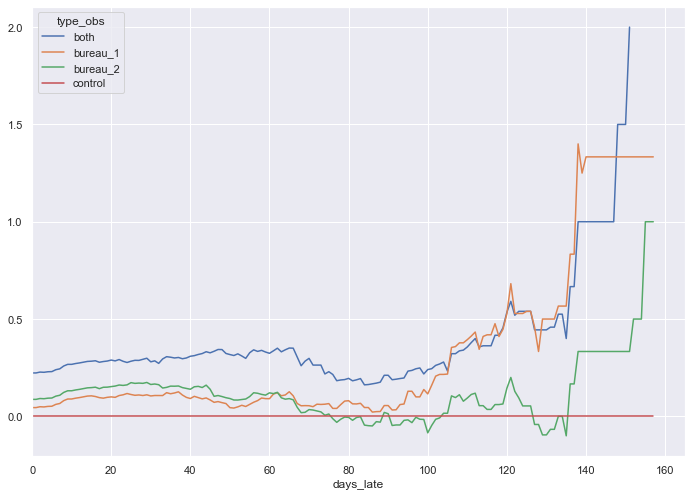

sum_spends_360


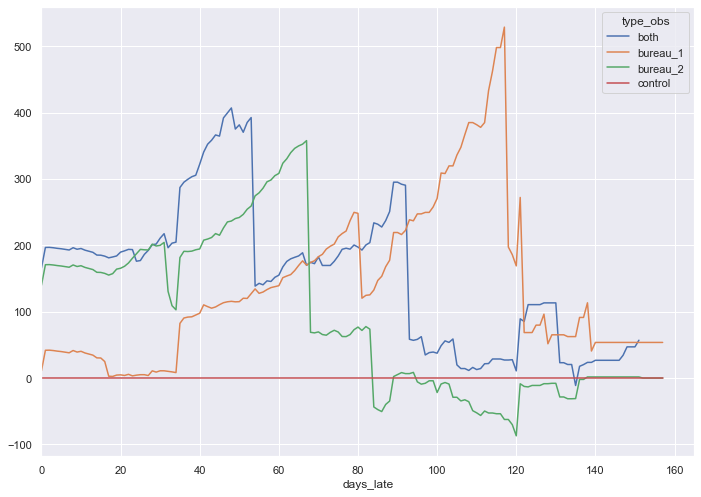

type_obs
collection_time


In [288]:
for i in  base.columns:
    try:
        print(i)
        (groupavgs[i].sub(groupavgs[(i,'control')],axis=0)).plot()
        plt.show()
    except:
        continue
    

In [171]:
a=pd.pivot(base.groupby(['type_obs','days_late']).mean(),columns='type_obs',index='days_late')

KeyError: "None of ['days_late', 'type_obs'] are in the columns"

In [19]:
base1=base.drop(['date','collections_start','collection__end'],axis=1).pivot(columns='id',index='days_late')

In [29]:
base['collection_time']=base['collection__end']-base['collections_start']

In [80]:
k=base[base ['bureau_2']==0] .drop_duplicates(['id'])['collection_time'].value_counts(dropna=False)


In [81]:
k

NaT         445
39 days      14
45 days      13
51 days      12
40 days      12
           ... 
9 days        1
123 days      1
116 days      1
82 days       1
93 days       1
Name: collection_time, Length: 127, dtype: int64

In [82]:
k/k.sum()

NaT         0.445
39 days     0.014
45 days     0.013
51 days     0.012
40 days     0.012
            ...  
9 days      0.001
123 days    0.001
116 days    0.001
82 days     0.001
93 days     0.001
Name: collection_time, Length: 127, dtype: float64

TypeError: count() takes exactly one argument (0 given)

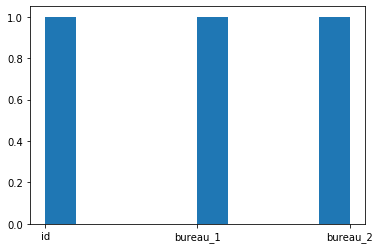

In [47]:
(['id','bureau_1','bureau_2']).count()

In [20]:
base1

bureau_1  \
id        001a43ae-9992-4eb8-9bfc-c2f9ef7c6711   
days_late                                        
0                                          0.0   
1                                          0.0   
2                                          0.0   
3                                          0.0   
4                                          0.0   
...                                        ...   
161                                        NaN   
162                                        NaN   
163                                        NaN   
164                                        NaN   
165                                        NaN   

                                                \
id        00471cfe-689d-44af-8eb2-ccf59a0c125a   
days_late                                        
0                                          0.0   
1                                          0.0   
2                                          0.0   
3                                          0.0   
4                                          0.0   
...                                        ...   
161                                        NaN   
162                                        NaN   
163                                        NaN   
164                                        NaN   
165                                        NaN   

                                                \
id        00edfcf2-2aba-4d97-9487-c94cbf2806a2   
days_late                                        
0                                          0.0   
1                                          0.0   
2                                          0.0   
3                                          0.0   
4                                          0.0   
...                                        ...   
161                                        NaN   
162                                        NaN   
163                                        NaN   
164                                        NaN   
165                                        NaN   

                                                \
id        014de82a-8871-4cbc-9cc8-c78e89fdd747   
days_late                                        
0                                          0.0   
1                                          0.0   
2                                          0.0   
3                                          0.0   
4                                          0.0   
...                                        ...   
161                                        NaN   
162                                        NaN   
163                                        NaN   
164                                        NaN   
165                                        NaN   

                                                \
id        01975101-1ea4-4c7c-a802-fafbccdf9d8f   
days_late                                        
0                                          0.0   
1                                          0.0   
2                                          0.0   
3                                          0.0   
4                                          0.0   
...                                        ...   
161                                        NaN   
162                                        NaN   
163                                        NaN   
164                                        NaN   
165                                        NaN   

                                                \
id        019aca98-038d-4ddd-a436-5c4a11231ed3   
days_late                                        
0                                          0.0   
1                                          0.0   
2                                          0.0   
3                                          0.0   
4                                          0.0   
...                                        ...   
161                                        NaN   
162                              

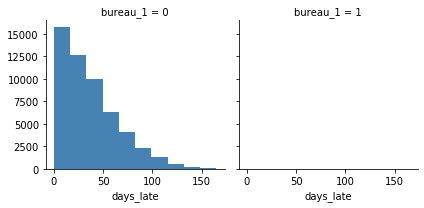

In [29]:

g = sns.FacetGrid(base.iloc[:,3:].select_dtypes(include='number'),  col="bureau_1", margin_titles=True)

g.map(plt.hist, "days_late", color="steelblue")

In [30]:
base.iloc[:,3:].select_dtypes(include='number').describe()

,days_late,bureau_1,bureau_2,late_payments,std_revolving_balance_30,agreement_amount_mean,oustanting_balance_weight_30,oustanting_balance_weight_90,max_installments_balance_90,max_payment_90,...,score_3,income_score_1,count_previous_delinquencies,income_score_2,age,mean_previous_delinquencies_amount_weight_180,mean_previous_delinquencies_duration_90,score_max_credit_limit,credit_limit_utilization,sum_spends_360
count,53939.000000,53939.000000,53939.000000,53939.000000,53939.000000,8615.000000,53939.000000,53939.00000,53939.000000,53939.000000,...,53748.000000,53148.000000,53939.000000,53929.000000,53939.000000,53939.000000,53939.00000,53939.000000,53939.000000,53939.000000
mean,36.569328,0.008139,0.007879,11.509298,7.313094,1850.127104,278.680343,10.69117,11.636274,4160.861343,...,157.192603,2007.253631,3.499564,4241.149604,41.168171,607.368323,11.30338,2252.656964,0.943232,206.534511
std,29.209864,0.089848,0.088416,21.098107,16.114278,1336.698371,1177.434203,16.77419,44.168598,6566.433172,...,162.498358,1415.893616,2.457865,4927.987435,9.071001,2687.838813,22.12957,1938.205017,0.552118,1378.392582
min,0.000000,0.000000,0.000000,0.000000,-1.000000,261.000000,-39.000000,0.00000,0.000000,-755.000000,...,3.000000,124.000000,0.000000,118.000000,19.000000,-300.000000,0.00000,192.000000,0.000000,0.000000
25%,14.000000,0.000000,0.000000,0.000000,3.000000,993.000000,40.000000,2.00000,1.000000,877.000000,...,56.000000,1079.000000,2.000000,1382.000000,35.000000,65.000000,1.00000,1058.000000,1.000000,1.000000
50%,30.000000,0.000000,0.000000,0.000000,4.000000,1451.000000,91.000000,5.00000,2.000000,2195.000000,...,108.000000,1627.000000,3.000000,2490.000000,40.000000,87.000000,4.00000,1732.000000,1.000000,7.000000
75%,53.000000,0.000000,0.000000,10.000000,7.000000,2294.000000,206.000000,11.00000,6.000000,4810.000000,...,200.000000,2513.000000,5.000000,5249.000000,46.000000,423.000000,11.00000,2766.000000,1.000000,43.000000
max,165.000000,1.000000,1.000000,620.000000,566.000000,9471.000000,38632.000000,183.00000,1029.000000,93248.000000,...,1639.000000,12764.000000,16.000000,66178.000000,81.000000,58921.000000,315.00000,17631.000000,3.000000,25925.000000


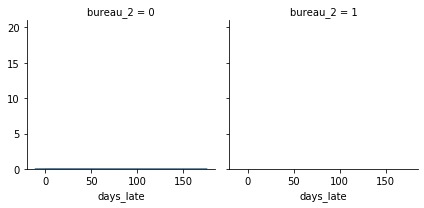

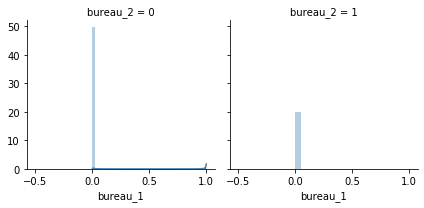

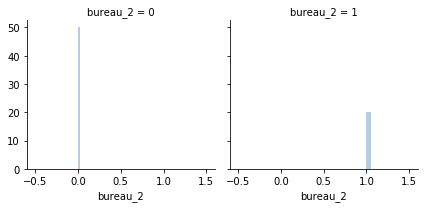

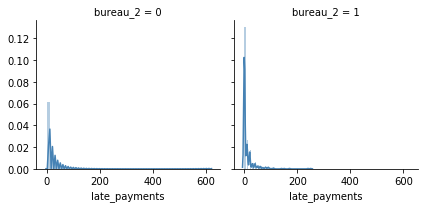

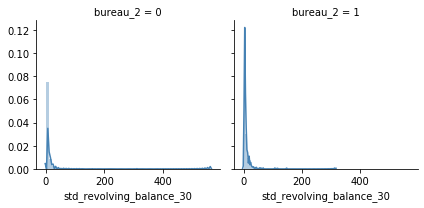

...

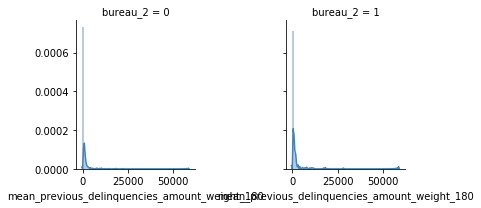

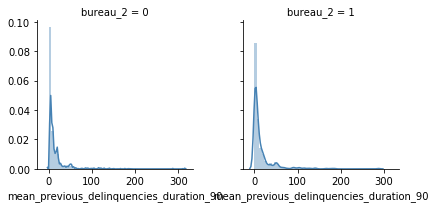

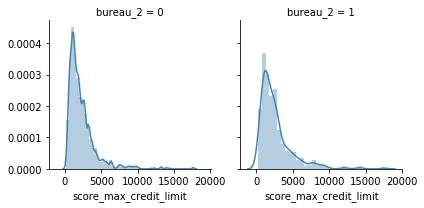

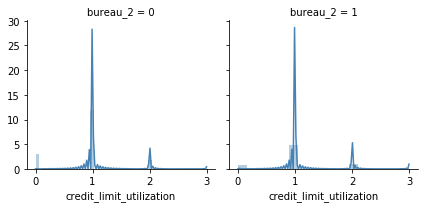

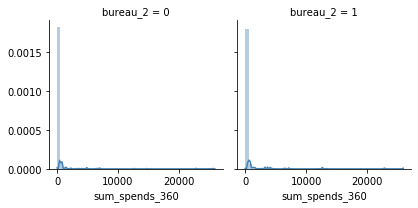

In [34]:
for i in  base.iloc[:,3:].select_dtypes(include='number').columns:
    g = sns.FacetGrid(base.iloc[:,3:].select_dtypes(include='number'),  col="bureau_2", margin_titles=True)

    g.map(sns.distplot, i, color="steelblue")
    plt.show()